# Afriat

In [1]:
scan=0.145

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: 78tcioki
Name: vibrant-capybara-136
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/78tcioki
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_121714-78tcioki/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2573,3288,9382
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2573,2584,1695,3400,1625,3366
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4468,10775
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 632,821,2357
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 632,618,413,890,424,833
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1116,2694
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:15<2:30:22, 15.06s/it]

Epoch 1/600:   0%|▎                                                                                                                                                         | 1/600 [00:15<2:30:22, 15.06s/it, v_num=ki_1, total_loss_train=3.7e+3, kl_local_train=43.4]

Epoch 2/600:   0%|▎                                                                                                                                                         | 1/600 [00:15<2:30:22, 15.06s/it, v_num=ki_1, total_loss_train=3.7e+3, kl_local_train=43.4]

Epoch 2/600:   0%|▌                                                                                                                                                         | 2/600 [00:28<2:23:10, 14.36s/it, v_num=ki_1, total_loss_train=3.7e+3, kl_local_train=43.4]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:28<2:23:10, 14.36s/it, v_num=ki_1, total_loss_train=3.23e+3, kl_local_train=57.3]

Epoch 3/600:   0%|▌                                                                                                                                                        | 2/600 [00:28<2:23:10, 14.36s/it, v_num=ki_1, total_loss_train=3.23e+3, kl_local_train=57.3]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:42<2:20:18, 14.10s/it, v_num=ki_1, total_loss_train=3.23e+3, kl_local_train=57.3]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:42<2:20:18, 14.10s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=55.7]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:42<2:20:18, 14.10s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=55.7]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:56<2:18:54, 13.98s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=55.7]

Epoch 4/600:   1%|█                                                                                                                                                          | 4/600 [00:56<2:18:54, 13.98s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=51]

Epoch 5/600:   1%|█                                                                                                                                                          | 4/600 [00:56<2:18:54, 13.98s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=51]

Epoch 5/600:   1%|█▎                                                                                                                                                         | 5/600 [01:10<2:18:25, 13.96s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=51]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:10<2:18:25, 13.96s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=43.9]

Epoch 6/600:   1%|█▎                                                                                                                                                       | 5/600 [01:11<2:18:25, 13.96s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=43.9]

Epoch 6/600:   1%|█▌                                                                                                                                                       | 6/600 [01:25<2:20:19, 14.17s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=43.9]

Epoch 6/600:   1%|▏                     | 6/600 [01:25<2:20:19, 14.17s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=33.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|▏                     | 6/600 [01:25<2:20:19, 14.17s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=33.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|▎                     | 7/600 [01:38<2:17:24, 13.90s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=33.5, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|▎                      | 7/600 [01:38<2:17:24, 13.90s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=30.4, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▎                      | 7/600 [01:38<2:17:24, 13.90s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=30.4, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▎                      | 8/600 [01:51<2:15:19, 13.71s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=30.4, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▎                     | 8/600 [01:51<2:15:19, 13.71s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=26.4, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 9/600:   1%|▎                     | 8/600 [01:51<2:15:19, 13.71s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=26.4, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▎                     | 9/600 [02:04<2:13:43, 13.58s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=26.4, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▎                     | 9/600 [02:04<2:13:43, 13.58s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=27.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▎                    | 9/600 [02:04<2:13:43, 13.58s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=27.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▎                   | 10/600 [02:18<2:12:56, 13.52s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=27.7, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▎                   | 10/600 [02:18<2:12:56, 13.52s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=32.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▎                   | 10/600 [02:19<2:12:56, 13.52s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=32.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▎                   | 11/600 [02:32<2:15:47, 13.83s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=32.8, metric_mi|status_control_train=0.019, metric_mi|zone_train=0.00976, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▍                    | 11/600 [02:32<2:15:47, 13.83s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 12/600:   2%|▍                    | 11/600 [02:32<2:15:47, 13.83s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 12/600:   2%|▍                    | 12/600 [02:46<2:13:52, 13.66s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 12/600:   2%|▍                    | 12/600 [02:46<2:13:52, 13.66s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 13/600:   2%|▍                    | 12/600 [02:46<2:13:52, 13.66s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 13/600:   2%|▍                    | 13/600 [02:59<2:12:24, 13.53s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 13/600:   2%|▍                    | 13/600 [02:59<2:12:24, 13.53s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 14/600:   2%|▍                    | 13/600 [02:59<2:12:24, 13.53s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 14/600:   2%|▍                    | 14/600 [03:12<2:11:16, 13.44s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 14/600:   2%|▍                    | 14/600 [03:12<2:11:16, 13.44s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 15/600:   2%|▍                    | 14/600 [03:12<2:11:16, 13.44s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 15/600:   2%|▌                    | 15/600 [03:25<2:10:46, 13.41s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 15/600:   2%|▌                    | 15/600 [03:25<2:10:46, 13.41s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=59.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 16/600:   2%|▌                    | 15/600 [03:27<2:10:46, 13.41s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=59.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 16/600:   3%|▌                    | 16/600 [03:40<2:13:57, 13.76s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=59.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.056]

Epoch 16/600:   3%|▌                     | 16/600 [03:40<2:13:57, 13.76s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 17/600:   3%|▌                     | 16/600 [03:40<2:13:57, 13.76s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 17/600:   3%|▌                     | 17/600 [03:53<2:12:21, 13.62s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 17/600:   3%|▌                     | 17/600 [03:53<2:12:21, 13.62s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=71.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 18/600:   3%|▌                     | 17/600 [03:53<2:12:21, 13.62s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=71.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 18/600:   3%|▋                     | 18/600 [04:07<2:11:22, 13.54s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=71.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 18/600:   3%|▋                     | 18/600 [04:07<2:11:22, 13.54s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 19/600:   3%|▋                     | 18/600 [04:07<2:11:22, 13.54s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 19/600:   3%|▋                     | 19/600 [04:20<2:10:38, 13.49s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 19/600:   3%|▋                     | 19/600 [04:20<2:10:38, 13.49s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 20/600:   3%|▋                     | 19/600 [04:20<2:10:38, 13.49s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 20/600:   3%|▋                     | 20/600 [04:33<2:10:08, 13.46s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 20/600:   3%|▊                       | 20/600 [04:33<2:10:08, 13.46s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=93, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 21/600:   3%|▊                       | 20/600 [04:35<2:10:08, 13.46s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=93, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 21/600:   4%|▊                       | 21/600 [04:48<2:13:21, 13.82s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=93, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.054, metric_mi|mouse_train=0.0742]

Epoch 21/600:   4%|▋                   | 21/600 [04:48<2:13:21, 13.82s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=96.8, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 22/600:   4%|▋                   | 21/600 [04:48<2:13:21, 13.82s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=96.8, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 22/600:   4%|▋                   | 22/600 [05:01<2:11:36, 13.66s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=96.8, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 22/600:   4%|▊                    | 22/600 [05:01<2:11:36, 13.66s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 23/600:   4%|▊                    | 22/600 [05:01<2:11:36, 13.66s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 23/600:   4%|▊                    | 23/600 [05:15<2:10:25, 13.56s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 23/600:   4%|▊                    | 23/600 [05:15<2:10:25, 13.56s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 24/600:   4%|▊                    | 23/600 [05:15<2:10:25, 13.56s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 24/600:   4%|▊                    | 24/600 [05:28<2:09:21, 13.48s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 24/600:   4%|▊                    | 24/600 [05:28<2:09:21, 13.48s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 25/600:   4%|▊                    | 24/600 [05:28<2:09:21, 13.48s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 25/600:   4%|▉                    | 25/600 [05:41<2:08:38, 13.42s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 25/600:   4%|▉                    | 25/600 [05:41<2:08:38, 13.42s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 26/600:   4%|▉                    | 25/600 [05:43<2:08:38, 13.42s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 26/600:   4%|▉                    | 26/600 [05:56<2:11:45, 13.77s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=111, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0608, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0966]

Epoch 26/600:   4%|█                        | 26/600 [05:56<2:11:45, 13.77s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|█                        | 26/600 [05:56<2:11:45, 13.77s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|█▏                       | 27/600 [06:09<2:10:12, 13.63s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|█▏                       | 27/600 [06:09<2:10:12, 13.63s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 28/600:   4%|█▏                       | 27/600 [06:09<2:10:12, 13.63s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|█▏                       | 28/600 [06:23<2:08:59, 13.53s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|█▏                       | 28/600 [06:23<2:08:59, 13.53s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|█▏                       | 28/600 [06:23<2:08:59, 13.53s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|█▏                       | 29/600 [06:36<2:08:05, 13.46s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|█▏                       | 29/600 [06:36<2:08:05, 13.46s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|█▏                       | 29/600 [06:36<2:08:05, 13.46s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|█▎                       | 30/600 [06:49<2:07:31, 13.42s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|█▎                       | 30/600 [06:49<2:07:31, 13.42s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|█▎                       | 30/600 [06:50<2:07:31, 13.42s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|█▎                       | 31/600 [07:04<2:10:41, 13.78s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|█▎                       | 31/600 [07:04<2:10:41, 13.78s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 32/600:   5%|█▎                       | 31/600 [07:04<2:10:41, 13.78s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 32/600:   5%|█▎                       | 32/600 [07:17<2:09:05, 13.64s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 32/600:   5%|█▎                       | 32/600 [07:17<2:09:05, 13.64s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 33/600:   5%|█▎                       | 32/600 [07:17<2:09:05, 13.64s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 33/600:   6%|█▍                       | 33/600 [07:30<2:07:54, 13.54s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 33/600:   6%|█▍                       | 33/600 [07:30<2:07:54, 13.54s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 34/600:   6%|█▍                       | 33/600 [07:30<2:07:54, 13.54s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 34/600:   6%|█▍                       | 34/600 [07:44<2:07:01, 13.46s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 34/600:   6%|█▍                       | 34/600 [07:44<2:07:01, 13.46s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 35/600:   6%|█▍                       | 34/600 [07:44<2:07:01, 13.46s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 35/600:   6%|█▍                       | 35/600 [07:57<2:06:30, 13.43s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 35/600:   6%|█▍                       | 35/600 [07:57<2:06:30, 13.43s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 36/600:   6%|█▍                       | 35/600 [07:58<2:06:30, 13.43s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 36/600:   6%|█▌                       | 36/600 [08:12<2:09:37, 13.79s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 36/600:   6%|█▌                        | 36/600 [08:12<2:09:37, 13.79s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 36/600 [08:12<2:09:37, 13.79s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 37/600 [08:25<2:08:06, 13.65s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▋                         | 37/600 [08:25<2:08:06, 13.65s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                         | 37/600 [08:25<2:08:06, 13.65s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                         | 38/600 [08:38<2:06:59, 13.56s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                         | 38/600 [08:38<2:06:59, 13.56s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                         | 38/600 [08:38<2:06:59, 13.56s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▊                         | 39/600 [08:52<2:06:08, 13.49s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▊                         | 39/600 [08:52<2:06:08, 13.49s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 40/600:   6%|█▊                         | 39/600 [08:52<2:06:08, 13.49s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 40/600:   7%|█▊                         | 40/600 [09:05<2:05:40, 13.47s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 40/600:   7%|█▊                         | 40/600 [09:05<2:05:40, 13.47s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                         | 40/600 [09:06<2:05:40, 13.47s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                         | 41/600 [09:20<2:08:57, 13.84s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                         | 41/600 [09:20<2:08:57, 13.84s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                         | 41/600 [09:20<2:08:57, 13.84s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▉                         | 42/600 [09:33<2:07:25, 13.70s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 42/600 [09:33<2:07:25, 13.70s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 42/600 [09:33<2:07:25, 13.70s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 43/600 [09:47<2:06:56, 13.67s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 43/600 [09:47<2:06:56, 13.67s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▊                        | 43/600 [09:47<2:06:56, 13.67s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▉                        | 44/600 [10:00<2:06:06, 13.61s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▉                        | 44/600 [10:00<2:06:06, 13.61s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 45/600:   7%|█▉                        | 44/600 [10:00<2:06:06, 13.61s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|█▉                        | 45/600 [10:14<2:05:14, 13.54s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=113, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|█▉                        | 45/600 [10:14<2:05:14, 13.54s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                        | 45/600 [10:15<2:05:14, 13.54s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                        | 46/600 [10:28<2:08:06, 13.88s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                       | 46/600 [10:28<2:08:06, 13.88s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                       | 46/600 [10:28<2:08:06, 13.88s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                       | 47/600 [10:42<2:06:34, 13.73s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                       | 47/600 [10:42<2:06:34, 13.73s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|█▉                       | 47/600 [10:42<2:06:34, 13.73s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                       | 48/600 [10:55<2:05:27, 13.64s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                       | 48/600 [10:55<2:05:27, 13.64s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=115, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                       | 48/600 [10:55<2:05:27, 13.64s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=115, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                       | 49/600 [11:09<2:04:49, 13.59s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=115, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                       | 49/600 [11:09<2:04:49, 13.59s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                       | 49/600 [11:09<2:04:49, 13.59s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                       | 50/600 [11:22<2:04:01, 13.53s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                       | 50/600 [11:22<2:04:01, 13.53s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██                       | 50/600 [11:23<2:04:01, 13.53s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                      | 51/600 [11:37<2:06:49, 13.86s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                       | 51/600 [11:37<2:06:49, 13.86s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 52/600:   8%|██▏                       | 51/600 [11:37<2:06:49, 13.86s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 52/600:   9%|██▎                       | 52/600 [11:50<2:05:16, 13.72s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 52/600:   9%|██▎                       | 52/600 [11:50<2:05:16, 13.72s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|██▎                       | 52/600 [11:50<2:05:16, 13.72s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|██▎                       | 53/600 [12:03<2:04:08, 13.62s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|██▎                       | 53/600 [12:03<2:04:08, 13.62s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|██▎                       | 53/600 [12:03<2:04:08, 13.62s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|██▎                       | 54/600 [12:17<2:03:16, 13.55s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|██▎                       | 54/600 [12:17<2:03:16, 13.55s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|██▎                       | 54/600 [12:17<2:03:16, 13.55s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|██▍                       | 55/600 [12:30<2:03:38, 13.61s/it, v_num=ki_1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|██▍                       | 55/600 [12:30<2:03:38, 13.61s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|██▍                       | 55/600 [12:32<2:03:38, 13.61s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|██▍                       | 56/600 [12:43<2:00:44, 13.32s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|██▎                      | 56/600 [12:43<2:00:44, 13.32s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 57/600:   9%|██▎                      | 56/600 [12:43<2:00:44, 13.32s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                      | 57/600 [12:54<1:55:12, 12.73s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                      | 57/600 [12:54<1:55:12, 12.73s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▍                      | 57/600 [12:54<1:55:12, 12.73s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▍                      | 58/600 [13:06<1:51:12, 12.31s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▍                      | 58/600 [13:06<1:51:12, 12.31s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▍                      | 58/600 [13:06<1:51:12, 12.31s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▍                      | 59/600 [13:17<1:48:21, 12.02s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▍                      | 59/600 [13:17<1:48:21, 12.02s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▍                      | 59/600 [13:17<1:48:21, 12.02s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                      | 60/600 [13:29<1:46:26, 11.83s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                      | 60/600 [13:29<1:46:26, 11.83s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▌                      | 60/600 [13:30<1:46:26, 11.83s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▌                      | 61/600 [13:41<1:48:19, 12.06s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▋                       | 61/600 [13:41<1:48:19, 12.06s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▋                       | 61/600 [13:41<1:48:19, 12.06s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▋                       | 62/600 [13:52<1:46:16, 11.85s/it, v_num=ki_1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▊                        | 62/600 [13:52<1:46:16, 11.85s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▊                        | 62/600 [13:53<1:46:16, 11.85s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▊                        | 63/600 [14:04<1:44:44, 11.70s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▊                        | 63/600 [14:04<1:44:44, 11.70s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 64/600:  10%|██▊                        | 63/600 [14:04<1:44:44, 11.70s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▉                        | 64/600 [14:15<1:43:41, 11.61s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▉                        | 64/600 [14:15<1:43:41, 11.61s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▉                        | 64/600 [14:15<1:43:41, 11.61s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▉                        | 65/600 [14:27<1:42:56, 11.55s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|███                         | 65/600 [14:27<1:42:56, 11.55s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|███                         | 65/600 [14:28<1:42:56, 11.55s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|███                         | 66/600 [14:39<1:45:33, 11.86s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▊                      | 66/600 [14:39<1:45:33, 11.86s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|██▊                      | 66/600 [14:39<1:45:33, 11.86s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|██▊                      | 67/600 [14:51<1:44:29, 11.76s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|██▊                      | 67/600 [14:51<1:44:29, 11.76s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|██▊                      | 67/600 [14:51<1:44:29, 11.76s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|██▊                      | 68/600 [15:02<1:43:25, 11.66s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|██▊                      | 68/600 [15:02<1:43:25, 11.66s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 69/600:  11%|██▊                      | 68/600 [15:02<1:43:25, 11.66s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 69/600:  12%|██▉                      | 69/600 [15:14<1:42:23, 11.57s/it, v_num=ki_1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 69/600:  12%|██▊                     | 69/600 [15:14<1:42:23, 11.57s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=96.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|██▊                     | 69/600 [15:14<1:42:23, 11.57s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=96.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|██▊                     | 70/600 [15:25<1:41:37, 11.51s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=96.1, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|███                       | 70/600 [15:25<1:41:37, 11.51s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=95, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|███                       | 70/600 [15:26<1:41:37, 11.51s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=95, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|███                       | 71/600 [15:38<1:44:20, 11.83s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=95, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|██▊                     | 71/600 [15:38<1:44:20, 11.83s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 72/600:  12%|██▊                     | 71/600 [15:38<1:44:20, 11.83s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 72/600:  12%|██▉                     | 72/600 [15:49<1:42:53, 11.69s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 72/600:  12%|██▉                     | 72/600 [15:49<1:42:53, 11.69s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 73/600:  12%|██▉                     | 72/600 [15:49<1:42:53, 11.69s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 73/600:  12%|██▉                     | 73/600 [16:00<1:41:51, 11.60s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=93.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 73/600:  12%|██▉                     | 73/600 [16:00<1:41:51, 11.60s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 74/600:  12%|██▉                     | 73/600 [16:00<1:41:51, 11.60s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 74/600:  12%|██▉                     | 74/600 [16:12<1:41:01, 11.52s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 74/600:  12%|██▉                     | 74/600 [16:12<1:41:01, 11.52s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=91.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 75/600:  12%|██▉                     | 74/600 [16:12<1:41:01, 11.52s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=91.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 75/600:  12%|███                     | 75/600 [16:23<1:40:17, 11.46s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=91.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 75/600:  12%|███                     | 75/600 [16:23<1:40:17, 11.46s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=90.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 76/600:  12%|███                     | 75/600 [16:24<1:40:17, 11.46s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=90.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 76/600:  13%|███                     | 76/600 [16:36<1:43:14, 11.82s/it, v_num=ki_1, total_loss_train=3.19e+3, kl_local_train=90.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 76/600:  13%|███                     | 76/600 [16:36<1:43:14, 11.82s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 77/600:  13%|███                     | 76/600 [16:36<1:43:14, 11.82s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 77/600:  13%|███                     | 77/600 [16:47<1:41:49, 11.68s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=90.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 77/600:  13%|███                     | 77/600 [16:47<1:41:49, 11.68s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 78/600:  13%|███                     | 77/600 [16:47<1:41:49, 11.68s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 78/600:  13%|███                     | 78/600 [16:58<1:40:46, 11.58s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=90.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 78/600:  13%|███                     | 78/600 [16:58<1:40:46, 11.58s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=88.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 79/600:  13%|███                     | 78/600 [16:58<1:40:46, 11.58s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=88.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 79/600:  13%|███▏                    | 79/600 [17:10<1:39:58, 11.51s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=88.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 79/600:  13%|███▏                    | 79/600 [17:10<1:39:58, 11.51s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 80/600:  13%|███▏                    | 79/600 [17:10<1:39:58, 11.51s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 80/600:  13%|███▏                    | 80/600 [17:21<1:39:33, 11.49s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=88.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 80/600:  13%|███▏                    | 80/600 [17:21<1:39:33, 11.49s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=87.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 81/600:  13%|███▏                    | 80/600 [17:22<1:39:33, 11.49s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=87.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 81/600:  14%|███▏                    | 81/600 [17:34<1:42:15, 11.82s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=87.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.128]

Epoch 81/600:  14%|███▌                      | 81/600 [17:34<1:42:15, 11.82s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 82/600:  14%|███▌                      | 81/600 [17:34<1:42:15, 11.82s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 82/600:  14%|███▌                      | 82/600 [17:45<1:40:56, 11.69s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=87, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 82/600:  14%|███▎                    | 82/600 [17:45<1:40:56, 11.69s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 83/600:  14%|███▎                    | 82/600 [17:45<1:40:56, 11.69s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 83/600:  14%|███▎                    | 83/600 [17:56<1:39:52, 11.59s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 83/600:  14%|███▎                    | 83/600 [17:56<1:39:52, 11.59s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 84/600:  14%|███▎                    | 83/600 [17:56<1:39:52, 11.59s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 84/600:  14%|███▎                    | 84/600 [18:08<1:39:03, 11.52s/it, v_num=ki_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 84/600:  14%|███▎                    | 84/600 [18:08<1:39:03, 11.52s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=85.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 85/600:  14%|███▎                    | 84/600 [18:08<1:39:03, 11.52s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=85.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 85/600:  14%|███▍                    | 85/600 [18:19<1:38:22, 11.46s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=85.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 85/600:  14%|███▍                    | 85/600 [18:19<1:38:22, 11.46s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 86/600:  14%|███▍                    | 85/600 [18:20<1:38:22, 11.46s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 86/600:  14%|███▍                    | 86/600 [18:32<1:41:07, 11.80s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.126]

Epoch 86/600:  14%|███▊                       | 86/600 [18:32<1:41:07, 11.80s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=84, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 87/600:  14%|███▊                       | 86/600 [18:32<1:41:07, 11.80s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=84, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 87/600:  14%|███▉                       | 87/600 [18:43<1:39:45, 11.67s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=84, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 87/600:  14%|███▌                     | 87/600 [18:43<1:39:45, 11.67s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 88/600:  14%|███▌                     | 87/600 [18:43<1:39:45, 11.67s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 88/600:  15%|███▋                     | 88/600 [18:54<1:38:44, 11.57s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=83.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 88/600:  15%|███▋                     | 88/600 [18:54<1:38:44, 11.57s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=83.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 89/600:  15%|███▋                     | 88/600 [18:54<1:38:44, 11.57s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=83.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 89/600:  15%|███▋                     | 89/600 [19:06<1:37:59, 11.51s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=83.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 89/600:  15%|███▋                     | 89/600 [19:06<1:37:59, 11.51s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=82.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 90/600:  15%|███▋                     | 89/600 [19:06<1:37:59, 11.51s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=82.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 90/600:  15%|███▊                     | 90/600 [19:17<1:37:58, 11.53s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=82.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 90/600:  15%|███▊                     | 90/600 [19:17<1:37:58, 11.53s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 91/600:  15%|███▊                     | 90/600 [19:19<1:37:58, 11.53s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 91/600:  15%|███▊                     | 91/600 [19:31<1:44:21, 12.30s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=81.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 91/600:  15%|███▊                     | 91/600 [19:31<1:44:21, 12.30s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|███▊                     | 91/600 [19:31<1:44:21, 12.30s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|███▊                     | 92/600 [19:45<1:47:03, 12.65s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|███▊                     | 92/600 [19:45<1:47:03, 12.65s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  15%|███▊                     | 92/600 [19:45<1:47:03, 12.65s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|███▉                     | 93/600 [19:58<1:49:05, 12.91s/it, v_num=ki_1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|███▉                     | 93/600 [19:58<1:49:05, 12.91s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|███▉                     | 93/600 [19:58<1:49:05, 12.91s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|███▉                     | 94/600 [20:12<1:50:13, 13.07s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|███▉                     | 94/600 [20:12<1:50:13, 13.07s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|███▉                     | 94/600 [20:12<1:50:13, 13.07s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|███▉                     | 95/600 [20:26<1:51:42, 13.27s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|███▉                     | 95/600 [20:26<1:51:42, 13.27s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|███▉                     | 95/600 [20:27<1:51:42, 13.27s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|████                     | 96/600 [20:40<1:55:09, 13.71s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|████                     | 96/600 [20:40<1:55:09, 13.71s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|████                     | 96/600 [20:40<1:55:09, 13.71s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|████                     | 97/600 [20:54<1:54:13, 13.63s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 97/600:  16%|████                     | 97/600 [20:54<1:54:13, 13.63s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|████                     | 97/600 [20:54<1:54:13, 13.63s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|████                     | 98/600 [21:07<1:53:28, 13.56s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 98/600:  16%|████                     | 98/600 [21:07<1:53:28, 13.56s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=78.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|████                     | 98/600 [21:07<1:53:28, 13.56s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=78.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|████▏                    | 99/600 [21:21<1:52:54, 13.52s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=78.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 99/600:  16%|████▏                    | 99/600 [21:21<1:52:54, 13.52s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 100/600:  16%|███▉                    | 99/600 [21:21<1:52:54, 13.52s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 100/600:  17%|███▊                   | 100/600 [21:34<1:52:31, 13.50s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 100/600:  17%|███▊                   | 100/600 [21:34<1:52:31, 13.50s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|███▊                   | 100/600 [21:35<1:52:31, 13.50s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|███▊                   | 101/600 [21:47<1:50:11, 13.25s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 101/600:  17%|███▋                  | 101/600 [21:47<1:50:11, 13.25s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|███▋                  | 101/600 [21:47<1:50:11, 13.25s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|███▋                  | 102/600 [21:58<1:45:18, 12.69s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 102/600:  17%|███▋                  | 102/600 [21:58<1:45:18, 12.69s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|███▋                  | 102/600 [21:58<1:45:18, 12.69s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|███▊                  | 103/600 [22:09<1:41:45, 12.28s/it, v_num=ki_1, total_loss_train=3.16e+3, kl_local_train=76.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 103/600:  17%|███▊                  | 103/600 [22:09<1:41:45, 12.28s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|███▊                  | 103/600 [22:09<1:41:45, 12.28s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|███▊                  | 104/600 [22:21<1:39:14, 12.01s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=76.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 104/600:  17%|███▊                  | 104/600 [22:21<1:39:14, 12.01s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 105/600:  17%|███▊                  | 104/600 [22:21<1:39:14, 12.01s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 105/600:  18%|███▊                  | 105/600 [22:32<1:38:10, 11.90s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 105/600:  18%|███▊                  | 105/600 [22:32<1:38:10, 11.90s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|███▊                  | 105/600 [22:34<1:38:10, 11.90s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|███▉                  | 106/600 [22:45<1:39:41, 12.11s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 106/600:  18%|████                   | 106/600 [22:45<1:39:41, 12.11s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 107/600:  18%|████                   | 106/600 [22:45<1:39:41, 12.11s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 107/600:  18%|████                   | 107/600 [22:56<1:37:37, 11.88s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 107/600:  18%|████▍                    | 107/600 [22:56<1:37:37, 11.88s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 108/600:  18%|████▍                    | 107/600 [22:56<1:37:37, 11.88s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 108/600:  18%|████▌                    | 108/600 [23:08<1:36:07, 11.72s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=75, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 108/600:  18%|████▏                  | 108/600 [23:08<1:36:07, 11.72s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 109/600:  18%|████▏                  | 108/600 [23:08<1:36:07, 11.72s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 109/600:  18%|████▏                  | 109/600 [23:19<1:35:01, 11.61s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=74.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 109/600:  18%|████▏                  | 109/600 [23:19<1:35:01, 11.61s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 110/600:  18%|████▏                  | 109/600 [23:19<1:35:01, 11.61s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 110/600:  18%|████▏                  | 110/600 [23:30<1:34:09, 11.53s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 110/600:  18%|████▏                  | 110/600 [23:30<1:34:09, 11.53s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 111/600:  18%|████▏                  | 110/600 [23:32<1:34:09, 11.53s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 111/600:  18%|████▎                  | 111/600 [23:43<1:36:31, 11.84s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 111/600:  18%|████▋                    | 111/600 [23:43<1:36:31, 11.84s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 112/600:  18%|████▋                    | 111/600 [23:43<1:36:31, 11.84s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 112/600:  19%|████▋                    | 112/600 [23:54<1:35:07, 11.70s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 112/600:  19%|████▎                  | 112/600 [23:54<1:35:07, 11.70s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 113/600:  19%|████▎                  | 112/600 [23:54<1:35:07, 11.70s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 113/600:  19%|████▎                  | 113/600 [24:06<1:34:06, 11.59s/it, v_num=ki_1, total_loss_train=3.15e+3, kl_local_train=73.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 113/600:  19%|████▎                  | 113/600 [24:06<1:34:06, 11.59s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 114/600:  19%|████▎                  | 113/600 [24:06<1:34:06, 11.59s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 114/600:  19%|████▎                  | 114/600 [24:17<1:33:24, 11.53s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 114/600:  19%|████▎                  | 114/600 [24:17<1:33:24, 11.53s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 115/600:  19%|████▎                  | 114/600 [24:17<1:33:24, 11.53s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 115/600:  19%|████▍                  | 115/600 [24:28<1:32:48, 11.48s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 115/600:  19%|████▍                  | 115/600 [24:28<1:32:48, 11.48s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 116/600:  19%|████▍                  | 115/600 [24:30<1:32:48, 11.48s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 116/600:  19%|████▍                  | 116/600 [24:41<1:35:21, 11.82s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 116/600:  19%|████▋                   | 116/600 [24:41<1:35:21, 11.82s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 117/600:  19%|████▋                   | 116/600 [24:41<1:35:21, 11.82s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 117/600:  20%|████▋                   | 117/600 [24:53<1:34:19, 11.72s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 117/600:  20%|████▋                   | 117/600 [24:53<1:34:19, 11.72s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 118/600:  20%|████▋                   | 117/600 [24:53<1:34:19, 11.72s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 118/600:  20%|████▋                   | 118/600 [25:04<1:33:24, 11.63s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 118/600:  20%|████▋                   | 118/600 [25:04<1:33:24, 11.63s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 119/600:  20%|████▋                   | 118/600 [25:04<1:33:24, 11.63s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 119/600:  20%|████▊                   | 119/600 [25:15<1:32:36, 11.55s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 119/600:  20%|████▊                   | 119/600 [25:15<1:32:36, 11.55s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 120/600:  20%|████▊                   | 119/600 [25:15<1:32:36, 11.55s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 120/600:  20%|████▊                   | 120/600 [25:27<1:31:52, 11.48s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=71.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 120/600:  20%|████▊                   | 120/600 [25:27<1:31:52, 11.48s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 121/600:  20%|████▊                   | 120/600 [25:28<1:31:52, 11.48s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 121/600:  20%|████▊                   | 121/600 [25:39<1:34:25, 11.83s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 121/600:  20%|████▋                  | 121/600 [25:39<1:34:25, 11.83s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 122/600:  20%|████▋                  | 121/600 [25:39<1:34:25, 11.83s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 122/600:  20%|████▋                  | 122/600 [25:51<1:33:09, 11.69s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=70.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 122/600:  20%|████▋                  | 122/600 [25:51<1:33:09, 11.69s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 123/600:  20%|████▋                  | 122/600 [25:51<1:33:09, 11.69s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 123/600:  20%|████▋                  | 123/600 [26:02<1:32:10, 11.59s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 123/600:  20%|████▋                  | 123/600 [26:02<1:32:10, 11.59s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=69.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 124/600:  20%|████▋                  | 123/600 [26:02<1:32:10, 11.59s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=69.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 124/600:  21%|████▊                  | 124/600 [26:13<1:31:25, 11.52s/it, v_num=ki_1, total_loss_train=3.14e+3, kl_local_train=69.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 124/600:  21%|████▊                  | 124/600 [26:13<1:31:25, 11.52s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 125/600:  21%|████▊                  | 124/600 [26:13<1:31:25, 11.52s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 125/600:  21%|████▊                  | 125/600 [26:25<1:31:26, 11.55s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 125/600:  21%|████▊                  | 125/600 [26:25<1:31:26, 11.55s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 126/600:  21%|████▊                  | 125/600 [26:26<1:31:26, 11.55s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 126/600:  21%|████▊                  | 126/600 [26:38<1:33:46, 11.87s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 126/600:  21%|█████                   | 126/600 [26:38<1:33:46, 11.87s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 127/600:  21%|█████                   | 126/600 [26:38<1:33:46, 11.87s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 127/600:  21%|█████                   | 127/600 [26:49<1:32:24, 11.72s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=69, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 127/600:  21%|████▋                 | 127/600 [26:49<1:32:24, 11.72s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 128/600:  21%|████▋                 | 127/600 [26:49<1:32:24, 11.72s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 128/600:  21%|████▋                 | 128/600 [27:00<1:31:24, 11.62s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 128/600:  21%|████▋                 | 128/600 [27:00<1:31:24, 11.62s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 129/600:  21%|████▋                 | 128/600 [27:00<1:31:24, 11.62s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 129/600:  22%|████▋                 | 129/600 [27:12<1:30:34, 11.54s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 129/600:  22%|████▋                 | 129/600 [27:12<1:30:34, 11.54s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 130/600:  22%|████▋                 | 129/600 [27:12<1:30:34, 11.54s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 130/600:  22%|████▊                 | 130/600 [27:23<1:29:54, 11.48s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 130/600:  22%|████▊                 | 130/600 [27:23<1:29:54, 11.48s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 131/600:  22%|████▊                 | 130/600 [27:24<1:29:54, 11.48s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 131/600:  22%|████▊                 | 131/600 [27:36<1:32:20, 11.81s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 131/600:  22%|████▊                 | 131/600 [27:36<1:32:20, 11.81s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|████▊                 | 131/600 [27:36<1:32:20, 11.81s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|████▊                 | 132/600 [27:47<1:31:04, 11.68s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 132/600:  22%|████▊                 | 132/600 [27:47<1:31:04, 11.68s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|████▊                 | 132/600 [27:47<1:31:04, 11.68s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|████▉                 | 133/600 [27:58<1:30:07, 11.58s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 133/600:  22%|████▉                 | 133/600 [27:58<1:30:07, 11.58s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|████▉                 | 133/600 [27:58<1:30:07, 11.58s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|████▉                 | 134/600 [28:10<1:29:23, 11.51s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 134/600:  22%|█████▎                  | 134/600 [28:10<1:29:23, 11.51s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|█████▎                  | 134/600 [28:10<1:29:23, 11.51s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|█████▍                  | 135/600 [28:21<1:28:43, 11.45s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 135/600:  22%|████▉                 | 135/600 [28:21<1:28:43, 11.45s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 136/600:  22%|████▉                 | 135/600 [28:22<1:28:43, 11.45s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 136/600:  23%|████▉                 | 136/600 [28:34<1:31:07, 11.78s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 136/600:  23%|████▉                 | 136/600 [28:34<1:31:07, 11.78s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 137/600:  23%|████▉                 | 136/600 [28:34<1:31:07, 11.78s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 137/600:  23%|█████                 | 137/600 [28:45<1:29:53, 11.65s/it, v_num=ki_1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 137/600:  23%|█████                 | 137/600 [28:45<1:29:53, 11.65s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 138/600:  23%|█████                 | 137/600 [28:45<1:29:53, 11.65s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 138/600:  23%|█████                 | 138/600 [28:56<1:28:59, 11.56s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 138/600:  23%|█████▌                  | 138/600 [28:56<1:28:59, 11.56s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 139/600:  23%|█████▌                  | 138/600 [28:56<1:28:59, 11.56s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 139/600:  23%|█████▌                  | 139/600 [29:08<1:28:19, 11.49s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 139/600:  23%|█████                 | 139/600 [29:08<1:28:19, 11.49s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 140/600:  23%|█████                 | 139/600 [29:08<1:28:19, 11.49s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 140/600:  23%|█████▏                | 140/600 [29:19<1:27:43, 11.44s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 140/600:  23%|█████▏                | 140/600 [29:19<1:27:43, 11.44s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 141/600:  23%|█████▏                | 140/600 [29:20<1:27:43, 11.44s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 141/600:  24%|█████▏                | 141/600 [29:32<1:30:12, 11.79s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 141/600:  24%|█████▍                 | 141/600 [29:32<1:30:12, 11.79s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 142/600:  24%|█████▍                 | 141/600 [29:32<1:30:12, 11.79s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 142/600:  24%|█████▍                 | 142/600 [29:43<1:29:01, 11.66s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 142/600:  24%|█████▍                 | 142/600 [29:43<1:29:01, 11.66s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 143/600:  24%|█████▍                 | 142/600 [29:43<1:29:01, 11.66s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 143/600:  24%|█████▍                 | 143/600 [29:54<1:28:09, 11.57s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 143/600:  24%|█████▍                 | 143/600 [29:54<1:28:09, 11.57s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 144/600:  24%|█████▍                 | 143/600 [29:54<1:28:09, 11.57s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 144/600:  24%|█████▌                 | 144/600 [30:06<1:27:42, 11.54s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 144/600:  24%|█████▌                 | 144/600 [30:06<1:27:42, 11.54s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 145/600:  24%|█████▌                 | 144/600 [30:06<1:27:42, 11.54s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 145/600:  24%|█████▌                 | 145/600 [30:17<1:27:01, 11.48s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 145/600:  24%|█████▌                 | 145/600 [30:17<1:27:01, 11.48s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 146/600:  24%|█████▌                 | 145/600 [30:18<1:27:01, 11.48s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 146/600:  24%|█████▌                 | 146/600 [30:30<1:29:26, 11.82s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 146/600:  24%|█████▎                | 146/600 [30:30<1:29:26, 11.82s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 147/600:  24%|█████▎                | 146/600 [30:30<1:29:26, 11.82s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 147/600:  24%|█████▍                | 147/600 [30:41<1:28:16, 11.69s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 147/600:  24%|█████▍                | 147/600 [30:41<1:28:16, 11.69s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 148/600:  24%|█████▍                | 147/600 [30:41<1:28:16, 11.69s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 148/600:  25%|█████▍                | 148/600 [30:52<1:27:21, 11.60s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 148/600:  25%|█████▍                | 148/600 [30:52<1:27:21, 11.60s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 149/600:  25%|█████▍                | 148/600 [30:52<1:27:21, 11.60s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 149/600:  25%|█████▍                | 149/600 [31:04<1:26:37, 11.52s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 149/600:  25%|█████▉                  | 149/600 [31:04<1:26:37, 11.52s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 150/600:  25%|█████▉                  | 149/600 [31:04<1:26:37, 11.52s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 150/600:  25%|██████                  | 150/600 [31:15<1:25:58, 11.46s/it, v_num=ki_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 150/600:  25%|█████▌                | 150/600 [31:15<1:25:58, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 151/600:  25%|█████▌                | 150/600 [31:16<1:25:58, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 151/600:  25%|█████▌                | 151/600 [31:28<1:28:23, 11.81s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 151/600:  25%|█████▌                | 151/600 [31:28<1:28:23, 11.81s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|█████▌                | 151/600 [31:28<1:28:23, 11.81s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|█████▌                | 152/600 [31:39<1:27:12, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 152/600:  25%|█████▌                | 152/600 [31:39<1:27:12, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 153/600:  25%|█████▌                | 152/600 [31:39<1:27:12, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 153/600:  26%|█████▌                | 153/600 [31:51<1:26:21, 11.59s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 153/600:  26%|█████▌                | 153/600 [31:51<1:26:21, 11.59s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▌                | 153/600 [31:51<1:26:21, 11.59s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▋                | 154/600 [32:02<1:25:38, 11.52s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 154/600:  26%|█████▋                | 154/600 [32:02<1:25:38, 11.52s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▋                | 154/600 [32:02<1:25:38, 11.52s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|█████▋                | 155/600 [32:13<1:24:58, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 155/600:  26%|██████▏                 | 155/600 [32:13<1:24:58, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|██████▏                 | 155/600 [32:14<1:24:58, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|██████▏                 | 156/600 [32:26<1:27:25, 11.82s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 156/600:  26%|██████▌                  | 156/600 [32:26<1:27:25, 11.82s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 157/600:  26%|██████▌                  | 156/600 [32:26<1:27:25, 11.82s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 157/600:  26%|██████▌                  | 157/600 [32:37<1:26:13, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 157/600:  26%|██████▌                  | 157/600 [32:37<1:26:13, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 158/600:  26%|██████▌                  | 157/600 [32:37<1:26:13, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 158/600:  26%|██████▌                  | 158/600 [32:49<1:25:19, 11.58s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 158/600:  26%|██████▌                  | 158/600 [32:49<1:25:19, 11.58s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 159/600:  26%|██████▌                  | 158/600 [32:49<1:25:19, 11.58s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 159/600:  26%|██████▋                  | 159/600 [33:00<1:24:38, 11.51s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 159/600:  26%|██████▋                  | 159/600 [33:00<1:24:38, 11.51s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 160/600:  26%|██████▋                  | 159/600 [33:00<1:24:38, 11.51s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 160/600:  27%|██████▋                  | 160/600 [33:11<1:24:01, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 160/600:  27%|██████▋                  | 160/600 [33:11<1:24:01, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 161/600:  27%|██████▋                  | 160/600 [33:12<1:24:01, 11.46s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 161/600:  27%|██████▋                  | 161/600 [33:24<1:26:22, 11.81s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 161/600:  27%|█████▉                | 161/600 [33:24<1:26:22, 11.81s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 162/600:  27%|█████▉                | 161/600 [33:24<1:26:22, 11.81s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 162/600:  27%|█████▉                | 162/600 [33:35<1:25:14, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 162/600:  27%|█████▉                | 162/600 [33:35<1:25:14, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 163/600:  27%|█████▉                | 162/600 [33:35<1:25:14, 11.68s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 163/600:  27%|█████▉                | 163/600 [33:47<1:24:24, 11.59s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 163/600:  27%|█████▉                | 163/600 [33:47<1:24:24, 11.59s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 164/600:  27%|█████▉                | 163/600 [33:47<1:24:24, 11.59s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 164/600:  27%|██████                | 164/600 [33:58<1:23:46, 11.53s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 164/600:  27%|██████                | 164/600 [33:58<1:23:46, 11.53s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 165/600:  27%|██████                | 164/600 [33:58<1:23:46, 11.53s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 165/600:  28%|██████                | 165/600 [34:09<1:23:11, 11.48s/it, v_num=ki_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 165/600:  28%|██████▎                | 165/600 [34:09<1:23:11, 11.48s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 166/600:  28%|██████▎                | 165/600 [34:11<1:23:11, 11.48s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 166/600:  28%|██████▎                | 166/600 [34:22<1:25:31, 11.82s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 166/600:  28%|██████▋                 | 166/600 [34:22<1:25:31, 11.82s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 167/600:  28%|██████▋                 | 166/600 [34:22<1:25:31, 11.82s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 167/600:  28%|██████▋                 | 167/600 [34:33<1:24:25, 11.70s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 167/600:  28%|██████▋                 | 167/600 [34:33<1:24:25, 11.70s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 168/600:  28%|██████▋                 | 167/600 [34:33<1:24:25, 11.70s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 168/600:  28%|██████▋                 | 168/600 [34:45<1:23:34, 11.61s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 168/600:  28%|███████▎                  | 168/600 [34:45<1:23:34, 11.61s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 169/600:  28%|███████▎                  | 168/600 [34:45<1:23:34, 11.61s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 169/600:  28%|███████▎                  | 169/600 [34:56<1:22:57, 11.55s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 169/600:  28%|███████▎                  | 169/600 [34:56<1:22:57, 11.55s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 170/600:  28%|███████▎                  | 169/600 [34:56<1:22:57, 11.55s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 170/600:  28%|███████▎                  | 170/600 [35:08<1:22:38, 11.53s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=61, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 170/600:  28%|██████▊                 | 170/600 [35:08<1:22:38, 11.53s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 171/600:  28%|██████▊                 | 170/600 [35:09<1:22:38, 11.53s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 171/600:  28%|██████▊                 | 171/600 [35:20<1:24:53, 11.87s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.109]

Epoch 171/600:  28%|██████▌                | 171/600 [35:20<1:24:53, 11.87s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 172/600:  28%|██████▌                | 171/600 [35:20<1:24:53, 11.87s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 172/600:  29%|██████▌                | 172/600 [35:32<1:23:43, 11.74s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 172/600:  29%|██████▌                | 172/600 [35:32<1:23:43, 11.74s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 173/600:  29%|██████▌                | 172/600 [35:32<1:23:43, 11.74s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 173/600:  29%|██████▋                | 173/600 [35:43<1:22:50, 11.64s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 173/600:  29%|██████▋                | 173/600 [35:43<1:22:50, 11.64s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 174/600:  29%|██████▋                | 173/600 [35:43<1:22:50, 11.64s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 174/600:  29%|██████▋                | 174/600 [35:55<1:22:09, 11.57s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 174/600:  29%|██████▋                | 174/600 [35:55<1:22:09, 11.57s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 175/600:  29%|██████▋                | 174/600 [35:55<1:22:09, 11.57s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 175/600:  29%|██████▋                | 175/600 [36:06<1:21:32, 11.51s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 175/600:  29%|██████▋                | 175/600 [36:06<1:21:32, 11.51s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 176/600:  29%|██████▋                | 175/600 [36:07<1:21:32, 11.51s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 176/600:  29%|██████▋                | 176/600 [36:19<1:23:45, 11.85s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 176/600:  29%|███████▎                 | 176/600 [36:19<1:23:45, 11.85s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 177/600:  29%|███████▎                 | 176/600 [36:19<1:23:45, 11.85s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 177/600:  30%|███████▍                 | 177/600 [36:30<1:22:42, 11.73s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 177/600:  30%|███████▍                 | 177/600 [36:30<1:22:42, 11.73s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|███████▍                 | 177/600 [36:30<1:22:42, 11.73s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|███████▍                 | 178/600 [36:41<1:21:48, 11.63s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 178/600:  30%|██████▊                | 178/600 [36:41<1:21:48, 11.63s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██████▊                | 178/600 [36:41<1:21:48, 11.63s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██████▊                | 179/600 [36:53<1:21:09, 11.57s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 179/600:  30%|██████▊                | 179/600 [36:53<1:21:09, 11.57s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██████▊                | 179/600 [36:53<1:21:09, 11.57s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██████▉                | 180/600 [37:04<1:20:33, 11.51s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 180/600:  30%|██████▉                | 180/600 [37:04<1:20:33, 11.51s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|██████▉                | 180/600 [37:06<1:20:33, 11.51s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|██████▉                | 181/600 [37:17<1:22:43, 11.85s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 181/600:  30%|██████▉                | 181/600 [37:17<1:22:43, 11.85s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 182/600:  30%|██████▉                | 181/600 [37:17<1:22:43, 11.85s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 182/600:  30%|██████▉                | 182/600 [37:28<1:21:34, 11.71s/it, v_num=ki_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 182/600:  30%|██████▋               | 182/600 [37:28<1:21:34, 11.71s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 183/600:  30%|██████▋               | 182/600 [37:28<1:21:34, 11.71s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 183/600:  30%|██████▋               | 183/600 [37:40<1:20:43, 11.61s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 183/600:  30%|██████▋               | 183/600 [37:40<1:20:43, 11.61s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 184/600:  30%|██████▋               | 183/600 [37:40<1:20:43, 11.61s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 184/600:  31%|██████▋               | 184/600 [37:51<1:20:03, 11.55s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 184/600:  31%|██████▋               | 184/600 [37:51<1:20:03, 11.55s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 185/600:  31%|██████▋               | 184/600 [37:51<1:20:03, 11.55s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 185/600:  31%|██████▊               | 185/600 [38:03<1:19:40, 11.52s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 185/600:  31%|██████▊               | 185/600 [38:03<1:19:40, 11.52s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 186/600:  31%|██████▊               | 185/600 [38:04<1:19:40, 11.52s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 186/600:  31%|██████▊               | 186/600 [38:15<1:21:53, 11.87s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 186/600:  31%|███████▍                | 186/600 [38:15<1:21:53, 11.87s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 187/600:  31%|███████▍                | 186/600 [38:15<1:21:53, 11.87s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 187/600:  31%|███████▍                | 187/600 [38:27<1:20:42, 11.72s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=59, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 187/600:  31%|██████▊               | 187/600 [38:27<1:20:42, 11.72s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 188/600:  31%|██████▊               | 187/600 [38:27<1:20:42, 11.72s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 188/600:  31%|██████▉               | 188/600 [38:38<1:19:47, 11.62s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 188/600:  31%|██████▉               | 188/600 [38:38<1:19:47, 11.62s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 189/600:  31%|██████▉               | 188/600 [38:38<1:19:47, 11.62s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 189/600:  32%|██████▉               | 189/600 [38:49<1:19:06, 11.55s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 189/600:  32%|██████▉               | 189/600 [38:49<1:19:06, 11.55s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 190/600:  32%|██████▉               | 189/600 [38:49<1:19:06, 11.55s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 190/600:  32%|██████▉               | 190/600 [39:01<1:19:09, 11.58s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 190/600:  32%|██████▉               | 190/600 [39:01<1:19:09, 11.58s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 191/600:  32%|██████▉               | 190/600 [39:02<1:19:09, 11.58s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 191/600:  32%|███████               | 191/600 [39:14<1:21:05, 11.89s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 191/600:  32%|██████▎             | 191/600 [39:14<1:21:05, 11.89s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 192/600:  32%|██████▎             | 191/600 [39:14<1:21:05, 11.89s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 192/600:  32%|██████▍             | 192/600 [39:25<1:19:53, 11.75s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 192/600:  32%|██████▍             | 192/600 [39:25<1:19:53, 11.75s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 193/600:  32%|██████▍             | 192/600 [39:25<1:19:53, 11.75s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 193/600:  32%|██████▍             | 193/600 [39:36<1:18:57, 11.64s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 193/600:  32%|██████▍             | 193/600 [39:36<1:18:57, 11.64s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 194/600:  32%|██████▍             | 193/600 [39:36<1:18:57, 11.64s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 194/600:  32%|██████▍             | 194/600 [39:48<1:18:14, 11.56s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 194/600:  32%|███████               | 194/600 [39:48<1:18:14, 11.56s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 195/600:  32%|███████               | 194/600 [39:48<1:18:14, 11.56s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 195/600:  32%|███████▏              | 195/600 [39:59<1:18:13, 11.59s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 195/600:  32%|███████▏              | 195/600 [39:59<1:18:13, 11.59s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 196/600:  32%|███████▏              | 195/600 [40:01<1:18:13, 11.59s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 196/600:  33%|███████▏              | 196/600 [40:12<1:20:10, 11.91s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.0991, metric_mi|time_cat_train=0.0988, metric_mi|mouse_train=0.102]

Epoch 196/600:  33%|██████▌             | 196/600 [40:12<1:20:10, 11.91s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 197/600:  33%|██████▌             | 196/600 [40:12<1:20:10, 11.91s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 197/600:  33%|██████▌             | 197/600 [40:24<1:19:10, 11.79s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 197/600:  33%|██████▌             | 197/600 [40:24<1:19:10, 11.79s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 198/600:  33%|██████▌             | 197/600 [40:24<1:19:10, 11.79s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 198/600:  33%|██████▌             | 198/600 [40:35<1:18:11, 11.67s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 198/600:  33%|██████▌             | 198/600 [40:35<1:18:11, 11.67s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 199/600:  33%|██████▌             | 198/600 [40:35<1:18:11, 11.67s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 199/600:  33%|██████▋             | 199/600 [40:46<1:17:27, 11.59s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 199/600:  33%|██████▋             | 199/600 [40:46<1:17:27, 11.59s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 200/600:  33%|██████▋             | 199/600 [40:46<1:17:27, 11.59s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 200/600:  33%|██████▋             | 200/600 [40:58<1:16:56, 11.54s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 200/600:  33%|██████▋             | 200/600 [40:58<1:16:56, 11.54s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 201/600:  33%|██████▋             | 200/600 [40:59<1:16:56, 11.54s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 201/600:  34%|██████▋             | 201/600 [41:10<1:18:55, 11.87s/it, v_num=ki_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.0967, metric_mi|time_cat_train=0.0964, metric_mi|mouse_train=0.101]

Epoch 201/600:  34%|██████▎            | 201/600 [41:10<1:18:55, 11.87s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 202/600:  34%|██████▎            | 201/600 [41:11<1:18:55, 11.87s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 202/600:  34%|██████▍            | 202/600 [41:22<1:17:47, 11.73s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 202/600:  34%|██████▍            | 202/600 [41:22<1:17:47, 11.73s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 203/600:  34%|██████▍            | 202/600 [41:22<1:17:47, 11.73s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 203/600:  34%|██████▍            | 203/600 [41:33<1:16:57, 11.63s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 203/600:  34%|██████▍            | 203/600 [41:33<1:16:57, 11.63s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 204/600:  34%|██████▍            | 203/600 [41:33<1:16:57, 11.63s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 204/600:  34%|██████▍            | 204/600 [41:45<1:16:19, 11.57s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 204/600:  34%|██████▍            | 204/600 [41:45<1:16:19, 11.57s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 205/600:  34%|██████▍            | 204/600 [41:45<1:16:19, 11.57s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 205/600:  34%|██████▍            | 205/600 [41:56<1:15:51, 11.52s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 205/600:  34%|██████▍            | 205/600 [41:56<1:15:51, 11.52s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 206/600:  34%|██████▍            | 205/600 [41:57<1:15:51, 11.52s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 206/600:  34%|██████▌            | 206/600 [42:09<1:17:52, 11.86s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0995]

Epoch 206/600:  34%|██████▊             | 206/600 [42:09<1:17:52, 11.86s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 207/600:  34%|██████▊             | 206/600 [42:09<1:17:52, 11.86s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 207/600:  34%|██████▉             | 207/600 [42:20<1:16:44, 11.72s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 207/600:  34%|██████▉             | 207/600 [42:20<1:16:44, 11.72s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 208/600:  34%|██████▉             | 207/600 [42:20<1:16:44, 11.72s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 208/600:  35%|██████▉             | 208/600 [42:32<1:15:55, 11.62s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 208/600:  35%|██████▉             | 208/600 [42:32<1:15:55, 11.62s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 209/600:  35%|██████▉             | 208/600 [42:32<1:15:55, 11.62s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 209/600:  35%|██████▉             | 209/600 [42:43<1:15:17, 11.55s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 209/600:  35%|██████▉             | 209/600 [42:43<1:15:17, 11.55s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 210/600:  35%|██████▉             | 209/600 [42:43<1:15:17, 11.55s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 210/600:  35%|███████             | 210/600 [42:54<1:14:41, 11.49s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 210/600:  35%|███████             | 210/600 [42:54<1:14:41, 11.49s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 211/600:  35%|███████             | 210/600 [42:56<1:14:41, 11.49s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 211/600:  35%|███████             | 211/600 [43:07<1:16:41, 11.83s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0929, metric_mi|mouse_train=0.0985]

Epoch 211/600:  35%|██████▋            | 211/600 [43:07<1:16:41, 11.83s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 212/600:  35%|██████▋            | 211/600 [43:07<1:16:41, 11.83s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 212/600:  35%|██████▋            | 212/600 [43:18<1:15:41, 11.71s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 212/600:  35%|██████▋            | 212/600 [43:18<1:15:41, 11.71s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 213/600:  35%|██████▋            | 212/600 [43:18<1:15:41, 11.71s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 213/600:  36%|██████▋            | 213/600 [43:30<1:14:53, 11.61s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 213/600:  36%|██████▋            | 213/600 [43:30<1:14:53, 11.61s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 214/600:  36%|██████▋            | 213/600 [43:30<1:14:53, 11.61s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 214/600:  36%|██████▊            | 214/600 [43:41<1:14:14, 11.54s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 214/600:  36%|██████▊            | 214/600 [43:41<1:14:14, 11.54s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 215/600:  36%|██████▊            | 214/600 [43:41<1:14:14, 11.54s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 215/600:  36%|██████▊            | 215/600 [43:52<1:13:40, 11.48s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 215/600:  36%|██████▊            | 215/600 [43:52<1:13:40, 11.48s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 216/600:  36%|██████▊            | 215/600 [43:54<1:13:40, 11.48s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 216/600:  36%|██████▊            | 216/600 [44:05<1:15:44, 11.83s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0934, metric_mi|mouse_train=0.0989]

Epoch 216/600:  36%|███████▌             | 216/600 [44:05<1:15:44, 11.83s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 217/600:  36%|███████▌             | 216/600 [44:05<1:15:44, 11.83s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 217/600:  36%|███████▌             | 217/600 [44:16<1:14:42, 11.70s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 217/600:  36%|███████▌             | 217/600 [44:16<1:14:42, 11.70s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 218/600:  36%|███████▌             | 217/600 [44:17<1:14:42, 11.70s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 218/600:  36%|███████▋             | 218/600 [44:28<1:13:54, 11.61s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 218/600:  36%|██████▉            | 218/600 [44:28<1:13:54, 11.61s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 219/600:  36%|██████▉            | 218/600 [44:28<1:13:54, 11.61s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 219/600:  36%|██████▉            | 219/600 [44:39<1:13:19, 11.55s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 219/600:  36%|██████▉            | 219/600 [44:39<1:13:19, 11.55s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 220/600:  36%|██████▉            | 219/600 [44:39<1:13:19, 11.55s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 220/600:  37%|██████▉            | 220/600 [44:51<1:12:58, 11.52s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 220/600:  37%|██████▉            | 220/600 [44:51<1:12:58, 11.52s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 221/600:  37%|██████▉            | 220/600 [44:52<1:12:58, 11.52s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 221/600:  37%|██████▉            | 221/600 [45:03<1:14:53, 11.86s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0974]

Epoch 221/600:  37%|███████▎            | 221/600 [45:03<1:14:53, 11.86s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 222/600:  37%|███████▎            | 221/600 [45:03<1:14:53, 11.86s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 222/600:  37%|███████▍            | 222/600 [45:15<1:13:52, 11.73s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 222/600:  37%|███████▍            | 222/600 [45:15<1:13:52, 11.73s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 223/600:  37%|███████▍            | 222/600 [45:15<1:13:52, 11.73s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 223/600:  37%|███████▍            | 223/600 [45:26<1:13:20, 11.67s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 223/600:  37%|███████▍            | 223/600 [45:26<1:13:20, 11.67s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 224/600:  37%|███████▍            | 223/600 [45:26<1:13:20, 11.67s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 224/600:  37%|███████▍            | 224/600 [45:38<1:12:39, 11.60s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 224/600:  37%|███████▍            | 224/600 [45:38<1:12:39, 11.60s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 225/600:  37%|███████▍            | 224/600 [45:38<1:12:39, 11.60s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 225/600:  38%|███████▌            | 225/600 [45:49<1:12:03, 11.53s/it, v_num=ki_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 225/600:  38%|███████▌            | 225/600 [45:49<1:12:03, 11.53s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 226/600:  38%|███████▌            | 225/600 [45:50<1:12:03, 11.53s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 226/600:  38%|███████▌            | 226/600 [46:02<1:13:51, 11.85s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.0966]

Epoch 226/600:  38%|███████▌            | 226/600 [46:02<1:13:51, 11.85s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 227/600:  38%|███████▌            | 226/600 [46:02<1:13:51, 11.85s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 227/600:  38%|███████▌            | 227/600 [46:13<1:12:44, 11.70s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 227/600:  38%|███████▌            | 227/600 [46:13<1:12:44, 11.70s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 228/600:  38%|███████▌            | 227/600 [46:13<1:12:44, 11.70s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 228/600:  38%|███████▌            | 228/600 [46:24<1:11:53, 11.59s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 228/600:  38%|███████▌            | 228/600 [46:24<1:11:53, 11.59s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 229/600:  38%|███████▌            | 228/600 [46:24<1:11:53, 11.59s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 229/600:  38%|███████▋            | 229/600 [46:36<1:11:14, 11.52s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 229/600:  38%|███████▋            | 229/600 [46:36<1:11:14, 11.52s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 230/600:  38%|███████▋            | 229/600 [46:36<1:11:14, 11.52s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 230/600:  38%|███████▋            | 230/600 [46:47<1:10:36, 11.45s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 230/600:  38%|███████▋            | 230/600 [46:47<1:10:36, 11.45s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 231/600:  38%|███████▋            | 230/600 [46:48<1:10:36, 11.45s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 231/600:  38%|███████▋            | 231/600 [47:00<1:12:33, 11.80s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0808, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0948]

Epoch 231/600:  38%|███████▎           | 231/600 [47:00<1:12:33, 11.80s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 232/600:  38%|███████▎           | 231/600 [47:00<1:12:33, 11.80s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 232/600:  39%|███████▎           | 232/600 [47:11<1:11:30, 11.66s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 232/600:  39%|███████▎           | 232/600 [47:11<1:11:30, 11.66s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 233/600:  39%|███████▎           | 232/600 [47:11<1:11:30, 11.66s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 233/600:  39%|███████▍           | 233/600 [47:22<1:10:42, 11.56s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 233/600:  39%|███████▍           | 233/600 [47:22<1:10:42, 11.56s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 234/600:  39%|███████▍           | 233/600 [47:22<1:10:42, 11.56s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 234/600:  39%|███████▍           | 234/600 [47:34<1:10:04, 11.49s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 234/600:  39%|███████▍           | 234/600 [47:34<1:10:04, 11.49s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 235/600:  39%|███████▍           | 234/600 [47:34<1:10:04, 11.49s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 235/600:  39%|███████▍           | 235/600 [47:45<1:09:32, 11.43s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 235/600:  39%|███████▍           | 235/600 [47:45<1:09:32, 11.43s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 236/600:  39%|███████▍           | 235/600 [47:46<1:09:32, 11.43s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 236/600:  39%|███████▍           | 236/600 [47:58<1:11:26, 11.77s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0956]

Epoch 236/600:  39%|███████▍           | 236/600 [47:58<1:11:26, 11.77s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 237/600:  39%|███████▍           | 236/600 [47:58<1:11:26, 11.77s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 237/600:  40%|███████▌           | 237/600 [48:09<1:10:28, 11.65s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 237/600:  40%|███████▌           | 237/600 [48:09<1:10:28, 11.65s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 238/600:  40%|███████▌           | 237/600 [48:09<1:10:28, 11.65s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 238/600:  40%|███████▌           | 238/600 [48:20<1:09:46, 11.57s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 238/600:  40%|███████▌           | 238/600 [48:20<1:09:46, 11.57s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 239/600:  40%|███████▌           | 238/600 [48:20<1:09:46, 11.57s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 239/600:  40%|███████▌           | 239/600 [48:32<1:09:08, 11.49s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 239/600:  40%|███████▌           | 239/600 [48:32<1:09:08, 11.49s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 240/600:  40%|███████▌           | 239/600 [48:32<1:09:08, 11.49s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 240/600:  40%|███████▌           | 240/600 [48:43<1:09:06, 11.52s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 240/600:  40%|███████▌           | 240/600 [48:43<1:09:06, 11.52s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 241/600:  40%|███████▌           | 240/600 [48:44<1:09:06, 11.52s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 241/600:  40%|███████▋           | 241/600 [48:56<1:11:17, 11.92s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 241/600:  40%|████████            | 241/600 [48:56<1:11:17, 11.92s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 242/600:  40%|████████            | 241/600 [48:56<1:11:17, 11.92s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 242/600:  40%|████████            | 242/600 [49:08<1:10:30, 11.82s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 242/600:  40%|████████            | 242/600 [49:08<1:10:30, 11.82s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 243/600:  40%|████████            | 242/600 [49:08<1:10:30, 11.82s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 243/600:  40%|████████            | 243/600 [49:19<1:09:56, 11.75s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 243/600:  40%|████████            | 243/600 [49:19<1:09:56, 11.75s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 244/600:  40%|████████            | 243/600 [49:19<1:09:56, 11.75s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 244/600:  41%|████████▏           | 244/600 [49:31<1:09:26, 11.70s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 244/600:  41%|████████▏           | 244/600 [49:31<1:09:26, 11.70s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 245/600:  41%|████████▏           | 244/600 [49:31<1:09:26, 11.70s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 245/600:  41%|████████▏           | 245/600 [49:43<1:09:27, 11.74s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 245/600:  41%|████████▉             | 245/600 [49:43<1:09:27, 11.74s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 246/600:  41%|████████▉             | 245/600 [49:44<1:09:27, 11.74s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 246/600:  41%|█████████             | 246/600 [49:55<1:11:11, 12.07s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0729, metric_mi|time_cat_train=0.0879, metric_mi|mouse_train=0.0953]

Epoch 246/600:  41%|████████▌            | 246/600 [49:55<1:11:11, 12.07s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 247/600:  41%|████████▌            | 246/600 [49:55<1:11:11, 12.07s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 247/600:  41%|████████▋            | 247/600 [50:07<1:10:07, 11.92s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 247/600:  41%|███████▊           | 247/600 [50:07<1:10:07, 11.92s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 248/600:  41%|███████▊           | 247/600 [50:07<1:10:07, 11.92s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 248/600:  41%|███████▊           | 248/600 [50:19<1:09:19, 11.82s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 248/600:  41%|███████▊           | 248/600 [50:19<1:09:19, 11.82s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 249/600:  41%|███████▊           | 248/600 [50:19<1:09:19, 11.82s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 249/600:  42%|███████▉           | 249/600 [50:30<1:09:00, 11.80s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 249/600:  42%|████████▋            | 249/600 [50:30<1:09:00, 11.80s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 250/600:  42%|████████▋            | 249/600 [50:30<1:09:00, 11.80s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 250/600:  42%|████████▊            | 250/600 [50:42<1:08:19, 11.71s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 250/600:  42%|███████▉           | 250/600 [50:42<1:08:19, 11.71s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 251/600:  42%|███████▉           | 250/600 [50:43<1:08:19, 11.71s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 251/600:  42%|███████▉           | 251/600 [50:55<1:10:01, 12.04s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0856, metric_mi|mouse_train=0.0939]

Epoch 251/600:  42%|████████▊            | 251/600 [50:55<1:10:01, 12.04s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 252/600:  42%|████████▊            | 251/600 [50:55<1:10:01, 12.04s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 252/600:  42%|████████▊            | 252/600 [51:06<1:08:59, 11.89s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 252/600:  42%|███████▉           | 252/600 [51:06<1:08:59, 11.89s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 253/600:  42%|███████▉           | 252/600 [51:06<1:08:59, 11.89s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 253/600:  42%|████████           | 253/600 [51:18<1:08:12, 11.79s/it, v_num=ki_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 253/600:  42%|████████           | 253/600 [51:18<1:08:12, 11.79s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 254/600:  42%|████████           | 253/600 [51:18<1:08:12, 11.79s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 254/600:  42%|████████           | 254/600 [51:29<1:07:33, 11.71s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 254/600:  42%|████████           | 254/600 [51:29<1:07:33, 11.71s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 255/600:  42%|████████           | 254/600 [51:29<1:07:33, 11.71s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 255/600:  42%|████████           | 255/600 [51:41<1:07:00, 11.65s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 255/600:  42%|████████           | 255/600 [51:41<1:07:00, 11.65s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 256/600:  42%|████████           | 255/600 [51:42<1:07:00, 11.65s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 256/600:  43%|████████           | 256/600 [51:54<1:08:46, 11.99s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0825, metric_mi|mouse_train=0.0919]

Epoch 256/600:  43%|████████           | 256/600 [51:54<1:08:46, 11.99s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 257/600:  43%|████████           | 256/600 [51:54<1:08:46, 11.99s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 257/600:  43%|████████▏          | 257/600 [52:05<1:07:51, 11.87s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 257/600:  43%|████████▏          | 257/600 [52:05<1:07:51, 11.87s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 258/600:  43%|████████▏          | 257/600 [52:05<1:07:51, 11.87s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 258/600:  43%|████████▏          | 258/600 [52:17<1:07:05, 11.77s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 258/600:  43%|████████▏          | 258/600 [52:17<1:07:05, 11.77s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 259/600:  43%|████████▏          | 258/600 [52:17<1:07:05, 11.77s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 259/600:  43%|████████▏          | 259/600 [52:28<1:06:31, 11.70s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 259/600:  43%|████████▏          | 259/600 [52:28<1:06:31, 11.70s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 260/600:  43%|████████▏          | 259/600 [52:28<1:06:31, 11.70s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 260/600:  43%|████████▏          | 260/600 [52:40<1:05:57, 11.64s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 260/600:  43%|████████▏          | 260/600 [52:40<1:05:57, 11.64s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 261/600:  43%|████████▏          | 260/600 [52:41<1:05:57, 11.64s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 261/600:  44%|████████▎          | 261/600 [52:53<1:07:40, 11.98s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0655, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0901]

Epoch 261/600:  44%|████████▎          | 261/600 [52:53<1:07:40, 11.98s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 262/600:  44%|████████▎          | 261/600 [52:53<1:07:40, 11.98s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 262/600:  44%|████████▎          | 262/600 [53:04<1:06:43, 11.85s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 262/600:  44%|████████▎          | 262/600 [53:04<1:06:43, 11.85s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 263/600:  44%|████████▎          | 262/600 [53:04<1:06:43, 11.85s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 263/600:  44%|████████▎          | 263/600 [53:16<1:05:59, 11.75s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 263/600:  44%|████████▎          | 263/600 [53:16<1:05:59, 11.75s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 264/600:  44%|████████▎          | 263/600 [53:16<1:05:59, 11.75s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 264/600:  44%|████████▎          | 264/600 [53:27<1:05:22, 11.68s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 264/600:  44%|████████▎          | 264/600 [53:27<1:05:22, 11.68s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 265/600:  44%|████████▎          | 264/600 [53:27<1:05:22, 11.68s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 265/600:  44%|████████▍          | 265/600 [53:39<1:04:49, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 265/600:  44%|████████▍          | 265/600 [53:39<1:04:49, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 266/600:  44%|████████▍          | 265/600 [53:40<1:04:49, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 266/600:  44%|████████▍          | 266/600 [53:51<1:06:31, 11.95s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0785, metric_mi|mouse_train=0.0896]

Epoch 266/600:  44%|████████▍          | 266/600 [53:51<1:06:31, 11.95s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 267/600:  44%|████████▍          | 266/600 [53:51<1:06:31, 11.95s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 267/600:  44%|████████▍          | 267/600 [54:03<1:05:35, 11.82s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 267/600:  44%|████████▍          | 267/600 [54:03<1:05:35, 11.82s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 268/600:  44%|████████▍          | 267/600 [54:03<1:05:35, 11.82s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 268/600:  45%|████████▍          | 268/600 [54:14<1:04:53, 11.73s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 268/600:  45%|████████▍          | 268/600 [54:14<1:04:53, 11.73s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 269/600:  45%|████████▍          | 268/600 [54:14<1:04:53, 11.73s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 269/600:  45%|████████▌          | 269/600 [54:26<1:04:18, 11.66s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 269/600:  45%|████████▌          | 269/600 [54:26<1:04:18, 11.66s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 270/600:  45%|████████▌          | 269/600 [54:26<1:04:18, 11.66s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 270/600:  45%|████████▌          | 270/600 [54:37<1:03:43, 11.58s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 270/600:  45%|████████▌          | 270/600 [54:37<1:03:43, 11.58s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 271/600:  45%|████████▌          | 270/600 [54:38<1:03:43, 11.58s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 271/600:  45%|████████▌          | 271/600 [54:50<1:05:26, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0767, metric_mi|mouse_train=0.0886]

Epoch 271/600:  45%|█████████▍           | 271/600 [54:50<1:05:26, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 272/600:  45%|█████████▍           | 271/600 [54:50<1:05:26, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 272/600:  45%|█████████▌           | 272/600 [55:01<1:04:29, 11.80s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 272/600:  45%|████████▌          | 272/600 [55:01<1:04:29, 11.80s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 273/600:  45%|████████▌          | 272/600 [55:01<1:04:29, 11.80s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 273/600:  46%|████████▋          | 273/600 [55:13<1:03:47, 11.71s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 273/600:  46%|████████▋          | 273/600 [55:13<1:03:47, 11.71s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 274/600:  46%|████████▋          | 273/600 [55:13<1:03:47, 11.71s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 274/600:  46%|████████▋          | 274/600 [55:24<1:03:14, 11.64s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 274/600:  46%|████████▋          | 274/600 [55:24<1:03:14, 11.64s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 275/600:  46%|████████▋          | 274/600 [55:24<1:03:14, 11.64s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 275/600:  46%|████████▋          | 275/600 [55:36<1:02:52, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 275/600:  46%|████████▋          | 275/600 [55:36<1:02:52, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 276/600:  46%|████████▋          | 275/600 [55:37<1:02:52, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 276/600:  46%|████████▋          | 276/600 [55:49<1:04:25, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0759, metric_mi|mouse_train=0.0879]

Epoch 276/600:  46%|█████████▏          | 276/600 [55:49<1:04:25, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 277/600:  46%|█████████▏          | 276/600 [55:49<1:04:25, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 277/600:  46%|█████████▏          | 277/600 [56:00<1:03:26, 11.79s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 277/600:  46%|█████████▏          | 277/600 [56:00<1:03:26, 11.79s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 278/600:  46%|█████████▏          | 277/600 [56:00<1:03:26, 11.79s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 278/600:  46%|█████████▎          | 278/600 [56:12<1:02:43, 11.69s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 278/600:  46%|██████████▏           | 278/600 [56:12<1:02:43, 11.69s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 279/600:  46%|██████████▏           | 278/600 [56:12<1:02:43, 11.69s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 279/600:  46%|██████████▏           | 279/600 [56:23<1:02:10, 11.62s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 279/600:  46%|█████████▎          | 279/600 [56:23<1:02:10, 11.62s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 280/600:  46%|█████████▎          | 279/600 [56:23<1:02:10, 11.62s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 280/600:  47%|█████████▎          | 280/600 [56:35<1:01:50, 11.60s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 280/600:  47%|█████████▎          | 280/600 [56:35<1:01:50, 11.60s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 281/600:  47%|█████████▎          | 280/600 [56:36<1:01:50, 11.60s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 281/600:  47%|█████████▎          | 281/600 [56:47<1:03:24, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 281/600:  47%|████████▉          | 281/600 [56:47<1:03:24, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 282/600:  47%|████████▉          | 281/600 [56:47<1:03:24, 11.93s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 282/600:  47%|████████▉          | 282/600 [56:59<1:02:25, 11.78s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 282/600:  47%|████████▉          | 282/600 [56:59<1:02:25, 11.78s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 283/600:  47%|████████▉          | 282/600 [56:59<1:02:25, 11.78s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 283/600:  47%|████████▉          | 283/600 [57:10<1:01:40, 11.67s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 283/600:  47%|████████▉          | 283/600 [57:10<1:01:40, 11.67s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 284/600:  47%|████████▉          | 283/600 [57:10<1:01:40, 11.67s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 284/600:  47%|████████▉          | 284/600 [57:22<1:01:09, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 284/600:  47%|████████▉          | 284/600 [57:22<1:01:09, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 285/600:  47%|████████▉          | 284/600 [57:22<1:01:09, 11.61s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 285/600:  48%|█████████          | 285/600 [57:33<1:00:41, 11.56s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 285/600:  48%|█████████          | 285/600 [57:33<1:00:41, 11.56s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 286/600:  48%|█████████          | 285/600 [57:34<1:00:41, 11.56s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 286/600:  48%|█████████          | 286/600 [57:46<1:02:14, 11.89s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0865]

Epoch 286/600:  48%|█████████▌          | 286/600 [57:46<1:02:14, 11.89s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 287/600:  48%|█████████▌          | 286/600 [57:46<1:02:14, 11.89s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 287/600:  48%|█████████▌          | 287/600 [57:57<1:01:18, 11.75s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 287/600:  48%|█████████▌          | 287/600 [57:57<1:01:18, 11.75s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 288/600:  48%|█████████▌          | 287/600 [57:57<1:01:18, 11.75s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 288/600:  48%|█████████▌          | 288/600 [58:09<1:00:35, 11.65s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 288/600:  48%|█████████▌          | 288/600 [58:09<1:00:35, 11.65s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 289/600:  48%|█████████▌          | 288/600 [58:09<1:00:35, 11.65s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 289/600:  48%|█████████▋          | 289/600 [58:20<1:00:04, 11.59s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 289/600:  48%|█████████▋          | 289/600 [58:20<1:00:04, 11.59s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 290/600:  48%|█████████▋          | 289/600 [58:20<1:00:04, 11.59s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 290/600:  48%|██████████▋           | 290/600 [58:31<59:31, 11.52s/it, v_num=ki_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 290/600:  48%|██████████▋           | 290/600 [58:31<59:31, 11.52s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 291/600:  48%|██████████▋           | 290/600 [58:33<59:31, 11.52s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 291/600:  48%|█████████▋          | 291/600 [58:44<1:01:02, 11.85s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.086]

Epoch 291/600:  48%|████████▋         | 291/600 [58:44<1:01:02, 11.85s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 292/600:  48%|████████▋         | 291/600 [58:44<1:01:02, 11.85s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 292/600:  49%|████████▊         | 292/600 [58:55<1:00:11, 11.73s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 292/600:  49%|████████▊         | 292/600 [58:55<1:00:11, 11.73s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 293/600:  49%|████████▊         | 292/600 [58:55<1:00:11, 11.73s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 293/600:  49%|█████████▊          | 293/600 [59:07<59:32, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 293/600:  49%|█████████▊          | 293/600 [59:07<59:32, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 294/600:  49%|█████████▊          | 293/600 [59:07<59:32, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 294/600:  49%|█████████▊          | 294/600 [59:18<58:59, 11.57s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 294/600:  49%|█████████▊          | 294/600 [59:18<58:59, 11.57s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 295/600:  49%|█████████▊          | 294/600 [59:18<58:59, 11.57s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 295/600:  49%|█████████▊          | 295/600 [59:30<58:28, 11.50s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 295/600:  49%|█████████▊          | 295/600 [59:30<58:28, 11.50s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 296/600:  49%|█████████▊          | 295/600 [59:31<58:28, 11.50s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 296/600:  49%|████████▉         | 296/600 [59:42<1:00:00, 11.84s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0998, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0844]

Epoch 296/600:  49%|█████████▎         | 296/600 [59:42<1:00:00, 11.84s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 297/600:  49%|█████████▎         | 296/600 [59:42<1:00:00, 11.84s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 297/600:  50%|██████████▍          | 297/600 [59:54<59:10, 11.72s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 297/600:  50%|██████████▍          | 297/600 [59:54<59:10, 11.72s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 298/600:  50%|██████████▍          | 297/600 [59:54<59:10, 11.72s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 298/600:  50%|█████████▍         | 298/600 [1:00:05<58:31, 11.63s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 298/600:  50%|█████████▍         | 298/600 [1:00:05<58:31, 11.63s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 299/600:  50%|█████████▍         | 298/600 [1:00:05<58:31, 11.63s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 299/600:  50%|█████████▍         | 299/600 [1:00:17<58:03, 11.57s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 299/600:  50%|█████████▍         | 299/600 [1:00:17<58:03, 11.57s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 300/600:  50%|█████████▍         | 299/600 [1:00:17<58:03, 11.57s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 300/600:  50%|█████████▌         | 300/600 [1:00:28<57:42, 11.54s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 300/600:  50%|█████████▌         | 300/600 [1:00:28<57:42, 11.54s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 301/600:  50%|█████████▌         | 300/600 [1:00:29<57:42, 11.54s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 301/600:  50%|█████████▌         | 301/600 [1:00:41<59:10, 11.87s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0988, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0691, metric_mi|mouse_train=0.0837]

Epoch 301/600:  50%|█████████         | 301/600 [1:00:41<59:10, 11.87s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 302/600:  50%|█████████         | 301/600 [1:00:41<59:10, 11.87s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 302/600:  50%|█████████         | 302/600 [1:00:52<58:17, 11.74s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 302/600:  50%|█████████         | 302/600 [1:00:52<58:17, 11.74s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 303/600:  50%|█████████         | 302/600 [1:00:52<58:17, 11.74s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 303/600:  50%|█████████         | 303/600 [1:01:03<57:36, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 303/600:  50%|█████████         | 303/600 [1:01:03<57:36, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 304/600:  50%|█████████         | 303/600 [1:01:03<57:36, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 304/600:  51%|█████████         | 304/600 [1:01:15<57:00, 11.56s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 304/600:  51%|█████████         | 304/600 [1:01:15<57:00, 11.56s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 305/600:  51%|█████████         | 304/600 [1:01:15<57:00, 11.56s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 305/600:  51%|█████████▏        | 305/600 [1:01:26<56:29, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 305/600:  51%|█████████▏        | 305/600 [1:01:26<56:29, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 306/600:  51%|█████████▏        | 305/600 [1:01:27<56:29, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 306/600:  51%|█████████▏        | 306/600 [1:01:39<57:58, 11.83s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.0828]

Epoch 306/600:  51%|█████████▏        | 306/600 [1:01:39<57:58, 11.83s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 307/600:  51%|█████████▏        | 306/600 [1:01:39<57:58, 11.83s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 307/600:  51%|█████████▏        | 307/600 [1:01:50<57:07, 11.70s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 307/600:  51%|█████████▏        | 307/600 [1:01:50<57:07, 11.70s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 308/600:  51%|█████████▏        | 307/600 [1:01:50<57:07, 11.70s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 308/600:  51%|█████████▏        | 308/600 [1:02:02<56:27, 11.60s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 308/600:  51%|█████████▏        | 308/600 [1:02:02<56:27, 11.60s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 309/600:  51%|█████████▏        | 308/600 [1:02:02<56:27, 11.60s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 309/600:  52%|█████████▎        | 309/600 [1:02:13<55:56, 11.54s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 309/600:  52%|█████████▎        | 309/600 [1:02:13<55:56, 11.54s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 310/600:  52%|█████████▎        | 309/600 [1:02:13<55:56, 11.54s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 310/600:  52%|█████████▎        | 310/600 [1:02:25<55:59, 11.59s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 310/600:  52%|█████████▎        | 310/600 [1:02:25<55:59, 11.59s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 311/600:  52%|█████████▎        | 310/600 [1:02:26<55:59, 11.59s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 311/600:  52%|█████████▎        | 311/600 [1:02:37<57:20, 11.91s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0827]

Epoch 311/600:  52%|█████████▎        | 311/600 [1:02:37<57:20, 11.91s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 312/600:  52%|█████████▎        | 311/600 [1:02:37<57:20, 11.91s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 312/600:  52%|█████████▎        | 312/600 [1:02:49<56:24, 11.75s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 312/600:  52%|█████████▎        | 312/600 [1:02:49<56:24, 11.75s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 313/600:  52%|█████████▎        | 312/600 [1:02:49<56:24, 11.75s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 313/600:  52%|█████████▍        | 313/600 [1:03:00<55:41, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 313/600:  52%|█████████▍        | 313/600 [1:03:00<55:41, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 314/600:  52%|█████████▍        | 313/600 [1:03:00<55:41, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 314/600:  52%|█████████▍        | 314/600 [1:03:11<55:07, 11.56s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 314/600:  52%|█████████▍        | 314/600 [1:03:11<55:07, 11.56s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 315/600:  52%|█████████▍        | 314/600 [1:03:11<55:07, 11.56s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 315/600:  52%|█████████▍        | 315/600 [1:03:23<54:42, 11.52s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 315/600:  52%|█████████▍        | 315/600 [1:03:23<54:42, 11.52s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 316/600:  52%|█████████▍        | 315/600 [1:03:24<54:42, 11.52s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 316/600:  53%|█████████▍        | 316/600 [1:03:35<55:50, 11.80s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0955, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0678, metric_mi|mouse_train=0.0829]

Epoch 316/600:  53%|█████████▍        | 316/600 [1:03:35<55:50, 11.80s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 317/600:  53%|█████████▍        | 316/600 [1:03:35<55:50, 11.80s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 317/600:  53%|█████████▌        | 317/600 [1:03:47<54:51, 11.63s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 317/600:  53%|█████████▌        | 317/600 [1:03:47<54:51, 11.63s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 318/600:  53%|█████████▌        | 317/600 [1:03:47<54:51, 11.63s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 318/600:  53%|█████████▌        | 318/600 [1:03:58<54:06, 11.51s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 318/600:  53%|█████████▌        | 318/600 [1:03:58<54:06, 11.51s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 319/600:  53%|█████████▌        | 318/600 [1:03:58<54:06, 11.51s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 319/600:  53%|█████████▌        | 319/600 [1:04:09<53:31, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 319/600:  53%|█████████▌        | 319/600 [1:04:09<53:31, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 320/600:  53%|█████████▌        | 319/600 [1:04:09<53:31, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 320/600:  53%|█████████▌        | 320/600 [1:04:21<53:37, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 320/600:  53%|█████████▌        | 320/600 [1:04:21<53:37, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 321/600:  53%|█████████▌        | 320/600 [1:04:22<53:37, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:04:33<54:46, 11.78s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0438, metric_mi|time_cat_train=0.0669, metric_mi|mouse_train=0.0823]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:04:33<54:46, 11.78s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 322/600:  54%|█████████▋        | 321/600 [1:04:33<54:46, 11.78s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:04:44<53:48, 11.61s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:04:44<53:48, 11.61s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 323/600:  54%|█████████▋        | 322/600 [1:04:44<53:48, 11.61s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:04:56<53:06, 11.50s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:04:56<53:06, 11.50s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 324/600:  54%|█████████▋        | 323/600 [1:04:56<53:06, 11.50s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:05:07<52:31, 11.42s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:05:07<52:31, 11.42s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 325/600:  54%|█████████▋        | 324/600 [1:05:07<52:31, 11.42s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:05:18<52:06, 11.37s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:05:18<52:06, 11.37s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 326/600:  54%|█████████▊        | 325/600 [1:05:19<52:06, 11.37s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:05:31<53:27, 11.71s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0665, metric_mi|mouse_train=0.0817]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:05:31<53:27, 11.71s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 327/600:  54%|█████████▊        | 326/600 [1:05:31<53:27, 11.71s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 327/600:  55%|█████████▊        | 327/600 [1:05:42<52:45, 11.59s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 327/600:  55%|█████████▊        | 327/600 [1:05:42<52:45, 11.59s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 328/600:  55%|█████████▊        | 327/600 [1:05:42<52:45, 11.59s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 328/600:  55%|█████████▊        | 328/600 [1:05:53<52:05, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 328/600:  55%|█████████▊        | 328/600 [1:05:53<52:05, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 329/600:  55%|█████████▊        | 328/600 [1:05:53<52:05, 11.49s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 329/600:  55%|█████████▊        | 329/600 [1:06:04<51:32, 11.41s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 329/600:  55%|█████████▊        | 329/600 [1:06:04<51:32, 11.41s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 330/600:  55%|█████████▊        | 329/600 [1:06:04<51:32, 11.41s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:06:16<51:04, 11.35s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 330/600:  55%|█████████▉        | 330/600 [1:06:16<51:04, 11.35s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 331/600:  55%|█████████▉        | 330/600 [1:06:17<51:04, 11.35s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:06:28<52:20, 11.68s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.0809]

Epoch 331/600:  55%|██████████▍        | 331/600 [1:06:28<52:20, 11.68s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 332/600:  55%|██████████▍        | 331/600 [1:06:28<52:20, 11.68s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 332/600:  55%|██████████▌        | 332/600 [1:06:39<51:35, 11.55s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 332/600:  55%|██████████▌        | 332/600 [1:06:39<51:35, 11.55s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 333/600:  55%|██████████▌        | 332/600 [1:06:39<51:35, 11.55s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 333/600:  56%|██████████▌        | 333/600 [1:06:50<50:57, 11.45s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 333/600:  56%|██████████▌        | 333/600 [1:06:50<50:57, 11.45s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 334/600:  56%|██████████▌        | 333/600 [1:06:50<50:57, 11.45s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 334/600:  56%|██████████▌        | 334/600 [1:07:02<50:25, 11.38s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 334/600:  56%|██████████▌        | 334/600 [1:07:02<50:25, 11.38s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 335/600:  56%|██████████▌        | 334/600 [1:07:02<50:25, 11.38s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 335/600:  56%|██████████▌        | 335/600 [1:07:13<50:00, 11.32s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 335/600:  56%|██████████▌        | 335/600 [1:07:13<50:00, 11.32s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 336/600:  56%|██████████▌        | 335/600 [1:07:14<50:00, 11.32s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 336/600:  56%|██████████▋        | 336/600 [1:07:25<51:17, 11.66s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0862, metric_mi|zone_train=0.041, metric_mi|time_cat_train=0.0623, metric_mi|mouse_train=0.0794]

Epoch 336/600:  56%|██████████        | 336/600 [1:07:25<51:17, 11.66s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 337/600:  56%|██████████        | 336/600 [1:07:25<51:17, 11.66s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 337/600:  56%|██████████        | 337/600 [1:07:37<50:31, 11.53s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 337/600:  56%|██████████        | 337/600 [1:07:37<50:31, 11.53s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 338/600:  56%|██████████        | 337/600 [1:07:37<50:31, 11.53s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 338/600:  56%|██████████▏       | 338/600 [1:07:48<49:54, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 338/600:  56%|██████████▏       | 338/600 [1:07:48<49:54, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 339/600:  56%|██████████▏       | 338/600 [1:07:48<49:54, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 339/600:  56%|██████████▏       | 339/600 [1:07:59<49:25, 11.36s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 339/600:  56%|██████████▏       | 339/600 [1:07:59<49:25, 11.36s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 340/600:  56%|██████████▏       | 339/600 [1:07:59<49:25, 11.36s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 340/600:  57%|██████████▏       | 340/600 [1:08:10<49:00, 11.31s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 340/600:  57%|██████████▏       | 340/600 [1:08:10<49:00, 11.31s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 341/600:  57%|██████████▏       | 340/600 [1:08:11<49:00, 11.31s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:08:23<50:14, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0865, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0787]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:08:23<50:14, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 342/600:  57%|██████████▏       | 341/600 [1:08:23<50:14, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:08:34<49:32, 11.52s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 342/600:  57%|███████████▍        | 342/600 [1:08:34<49:32, 11.52s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 343/600:  57%|███████████▍        | 342/600 [1:08:34<49:32, 11.52s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 343/600:  57%|███████████▍        | 343/600 [1:08:45<48:56, 11.43s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:08:45<48:56, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 344/600:  57%|██████████▎       | 343/600 [1:08:45<48:56, 11.43s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:08:56<48:27, 11.36s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:08:56<48:27, 11.36s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 345/600:  57%|██████████▎       | 344/600 [1:08:56<48:27, 11.36s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:09:07<48:02, 11.30s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 345/600:  57%|███████████▌        | 345/600 [1:09:07<48:02, 11.30s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 346/600:  57%|███████████▌        | 345/600 [1:09:09<48:02, 11.30s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 346/600:  58%|███████████▌        | 346/600 [1:09:20<49:17, 11.64s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0861, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0778]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:09:20<49:17, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 347/600:  58%|██████████▍       | 346/600 [1:09:20<49:17, 11.64s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:09:31<48:33, 11.51s/it, v_num=ki_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 347/600:  58%|███████████▌        | 347/600 [1:09:31<48:33, 11.51s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 348/600:  58%|███████████▌        | 347/600 [1:09:31<48:33, 11.51s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 348/600:  58%|███████████▌        | 348/600 [1:09:42<47:58, 11.42s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:09:42<47:58, 11.42s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 349/600:  58%|██████████▍       | 348/600 [1:09:42<47:58, 11.42s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:09:53<47:30, 11.35s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:09:53<47:30, 11.35s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 350/600:  58%|██████████▍       | 349/600 [1:09:53<47:30, 11.35s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:10:05<47:38, 11.43s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:10:05<47:38, 11.43s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 351/600:  58%|██████████▌       | 350/600 [1:10:06<47:38, 11.43s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:10:17<48:42, 11.74s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0396, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:10:17<48:42, 11.74s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 352/600:  58%|██████████▌       | 351/600 [1:10:18<48:42, 11.74s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:10:29<47:54, 11.59s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:10:29<47:54, 11.59s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 353/600:  59%|██████████▌       | 352/600 [1:10:29<47:54, 11.59s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:10:40<47:20, 11.50s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:10:40<47:20, 11.50s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 354/600:  59%|██████████▌       | 353/600 [1:10:40<47:20, 11.50s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:10:51<46:54, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:10:51<46:54, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 355/600:  59%|██████████▌       | 354/600 [1:10:51<46:54, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:11:03<46:29, 11.39s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:11:03<46:29, 11.39s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 356/600:  59%|██████████▋       | 355/600 [1:11:04<46:29, 11.39s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:11:15<47:34, 11.70s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:11:15<47:34, 11.70s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 357/600:  59%|██████████▋       | 356/600 [1:11:15<47:34, 11.70s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 357/600:  60%|██████████▋       | 357/600 [1:11:26<46:47, 11.55s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 357/600:  60%|██████████▋       | 357/600 [1:11:26<46:47, 11.55s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 358/600:  60%|██████████▋       | 357/600 [1:11:26<46:47, 11.55s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 358/600:  60%|██████████▋       | 358/600 [1:11:37<46:09, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 358/600:  60%|██████████▋       | 358/600 [1:11:37<46:09, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 359/600:  60%|██████████▋       | 358/600 [1:11:37<46:09, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 359/600:  60%|██████████▊       | 359/600 [1:11:49<45:42, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 359/600:  60%|██████████▊       | 359/600 [1:11:49<45:42, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 360/600:  60%|██████████▊       | 359/600 [1:11:49<45:42, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 360/600:  60%|██████████▊       | 360/600 [1:12:00<45:18, 11.33s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 360/600:  60%|██████████▊       | 360/600 [1:12:00<45:18, 11.33s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 361/600:  60%|██████████▊       | 360/600 [1:12:01<45:18, 11.33s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:12:12<46:26, 11.66s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0803, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0579, metric_mi|mouse_train=0.0767]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:12:12<46:26, 11.66s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 362/600:  60%|██████████▊       | 361/600 [1:12:12<46:26, 11.66s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:12:24<45:44, 11.53s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 362/600:  60%|██████████▊       | 362/600 [1:12:24<45:44, 11.53s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 363/600:  60%|██████████▊       | 362/600 [1:12:24<45:44, 11.53s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:12:35<45:11, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 363/600:  60%|██████████▉       | 363/600 [1:12:35<45:11, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 364/600:  60%|██████████▉       | 363/600 [1:12:35<45:11, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:12:46<44:44, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 364/600:  61%|██████████▉       | 364/600 [1:12:46<44:44, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 365/600:  61%|██████████▉       | 364/600 [1:12:46<44:44, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:12:57<44:20, 11.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 365/600:  61%|██████████▉       | 365/600 [1:12:57<44:20, 11.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 366/600:  61%|██████████▉       | 365/600 [1:12:58<44:20, 11.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:13:10<45:29, 11.66s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0781, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0757]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:13:10<45:29, 11.66s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 367/600:  61%|██████████▉       | 366/600 [1:13:10<45:29, 11.66s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 367/600:  61%|███████████       | 367/600 [1:13:21<44:48, 11.54s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 367/600:  61%|███████████       | 367/600 [1:13:21<44:48, 11.54s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 368/600:  61%|███████████       | 367/600 [1:13:21<44:48, 11.54s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 368/600:  61%|███████████       | 368/600 [1:13:32<44:16, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 368/600:  61%|███████████       | 368/600 [1:13:32<44:16, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 369/600:  61%|███████████       | 368/600 [1:13:32<44:16, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 369/600:  62%|███████████       | 369/600 [1:13:43<43:48, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 369/600:  62%|████████████▎       | 369/600 [1:13:43<43:48, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 370/600:  62%|████████████▎       | 369/600 [1:13:43<43:48, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 370/600:  62%|████████████▎       | 370/600 [1:13:55<43:25, 11.33s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 370/600:  62%|███████████       | 370/600 [1:13:55<43:25, 11.33s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 371/600:  62%|███████████       | 370/600 [1:13:56<43:25, 11.33s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:14:07<44:32, 11.67s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0754]

Epoch 371/600:  62%|████████████▎       | 371/600 [1:14:07<44:32, 11.67s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 372/600:  62%|████████████▎       | 371/600 [1:14:07<44:32, 11.67s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 372/600:  62%|████████████▍       | 372/600 [1:14:18<43:50, 11.54s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 372/600:  62%|████████████▍       | 372/600 [1:14:18<43:50, 11.54s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 373/600:  62%|████████████▍       | 372/600 [1:14:18<43:50, 11.54s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 373/600:  62%|████████████▍       | 373/600 [1:14:29<43:17, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 373/600:  62%|████████████▍       | 373/600 [1:14:29<43:17, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 374/600:  62%|████████████▍       | 373/600 [1:14:29<43:17, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 374/600:  62%|████████████▍       | 374/600 [1:14:41<42:51, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 374/600:  62%|████████████▍       | 374/600 [1:14:41<42:51, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 375/600:  62%|████████████▍       | 374/600 [1:14:41<42:51, 11.38s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 375/600:  62%|████████████▌       | 375/600 [1:14:52<42:55, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 375/600:  62%|████████████▌       | 375/600 [1:14:52<42:55, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 376/600:  62%|████████████▌       | 375/600 [1:14:54<42:55, 11.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 376/600:  63%|████████████▌       | 376/600 [1:15:05<44:14, 11.85s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0744]

Epoch 376/600:  63%|███████████▉       | 376/600 [1:15:05<44:14, 11.85s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 377/600:  63%|███████████▉       | 376/600 [1:15:05<44:14, 11.85s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 377/600:  63%|███████████▉       | 377/600 [1:15:17<43:40, 11.75s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 377/600:  63%|███████████▉       | 377/600 [1:15:17<43:40, 11.75s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 378/600:  63%|███████████▉       | 377/600 [1:15:17<43:40, 11.75s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 378/600:  63%|███████████▉       | 378/600 [1:15:28<43:37, 11.79s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 378/600:  63%|███████████▉       | 378/600 [1:15:28<43:37, 11.79s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 379/600:  63%|███████████▉       | 378/600 [1:15:29<43:37, 11.79s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 379/600:  63%|████████████       | 379/600 [1:15:40<43:30, 11.81s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 379/600:  63%|████████████       | 379/600 [1:15:40<43:30, 11.81s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 380/600:  63%|████████████       | 379/600 [1:15:40<43:30, 11.81s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 380/600:  63%|████████████       | 380/600 [1:15:52<43:22, 11.83s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 380/600:  63%|████████████       | 380/600 [1:15:52<43:22, 11.83s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 381/600:  63%|████████████       | 380/600 [1:15:53<43:22, 11.83s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 381/600:  64%|████████████       | 381/600 [1:16:05<43:49, 12.01s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.053, metric_mi|mouse_train=0.0736]

Epoch 381/600:  64%|███████████▍      | 381/600 [1:16:05<43:49, 12.01s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 382/600:  64%|███████████▍      | 381/600 [1:16:05<43:49, 12.01s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 382/600:  64%|███████████▍      | 382/600 [1:16:16<42:46, 11.77s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 382/600:  64%|███████████▍      | 382/600 [1:16:16<42:46, 11.77s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 383/600:  64%|███████████▍      | 382/600 [1:16:16<42:46, 11.77s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 383/600:  64%|███████████▍      | 383/600 [1:16:27<41:59, 11.61s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 383/600:  64%|███████████▍      | 383/600 [1:16:27<41:59, 11.61s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 384/600:  64%|███████████▍      | 383/600 [1:16:27<41:59, 11.61s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 384/600:  64%|███████████▌      | 384/600 [1:16:38<41:21, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 384/600:  64%|███████████▌      | 384/600 [1:16:38<41:21, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 385/600:  64%|███████████▌      | 384/600 [1:16:38<41:21, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:16:50<41:22, 11.55s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:16:50<41:22, 11.55s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 386/600:  64%|███████████▌      | 385/600 [1:16:51<41:22, 11.55s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 386/600:  64%|███████████▌      | 386/600 [1:17:02<42:07, 11.81s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0713, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0725]

Epoch 386/600:  64%|███████████▌      | 386/600 [1:17:02<42:07, 11.81s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 387/600:  64%|███████████▌      | 386/600 [1:17:02<42:07, 11.81s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 387/600:  64%|███████████▌      | 387/600 [1:17:14<41:15, 11.62s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 387/600:  64%|███████████▌      | 387/600 [1:17:14<41:15, 11.62s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 388/600:  64%|███████████▌      | 387/600 [1:17:14<41:15, 11.62s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 388/600:  65%|███████████▋      | 388/600 [1:17:25<40:36, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 388/600:  65%|███████████▋      | 388/600 [1:17:25<40:36, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 389/600:  65%|███████████▋      | 388/600 [1:17:25<40:36, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 389/600:  65%|███████████▋      | 389/600 [1:17:36<40:05, 11.40s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 389/600:  65%|███████████▋      | 389/600 [1:17:36<40:05, 11.40s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 390/600:  65%|███████████▋      | 389/600 [1:17:36<40:05, 11.40s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 390/600:  65%|███████████▋      | 390/600 [1:17:48<40:05, 11.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 390/600:  65%|█████████████       | 390/600 [1:17:48<40:05, 11.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 391/600:  65%|█████████████       | 390/600 [1:17:49<40:05, 11.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 391/600:  65%|█████████████       | 391/600 [1:18:00<40:56, 11.75s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0721]

Epoch 391/600:  65%|████████████▍      | 391/600 [1:18:00<40:56, 11.75s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 392/600:  65%|████████████▍      | 391/600 [1:18:00<40:56, 11.75s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 392/600:  65%|████████████▍      | 392/600 [1:18:11<40:11, 11.60s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 392/600:  65%|█████████████▋       | 392/600 [1:18:11<40:11, 11.60s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 393/600:  65%|█████████████▋       | 392/600 [1:18:11<40:11, 11.60s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 393/600:  66%|█████████████▊       | 393/600 [1:18:22<39:38, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 393/600:  66%|█████████████▊       | 393/600 [1:18:22<39:38, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 394/600:  66%|█████████████▊       | 393/600 [1:18:22<39:38, 11.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 394/600:  66%|█████████████▊       | 394/600 [1:18:34<39:09, 11.41s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 394/600:  66%|████████████▍      | 394/600 [1:18:34<39:09, 11.41s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 395/600:  66%|████████████▍      | 394/600 [1:18:34<39:09, 11.41s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 395/600:  66%|████████████▌      | 395/600 [1:18:45<39:07, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 395/600:  66%|████████████▌      | 395/600 [1:18:45<39:07, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 396/600:  66%|████████████▌      | 395/600 [1:18:46<39:07, 11.45s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 396/600:  66%|████████████▌      | 396/600 [1:18:58<39:55, 11.74s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0688, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0714]

Epoch 396/600:  66%|███████████▉      | 396/600 [1:18:58<39:55, 11.74s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 397/600:  66%|███████████▉      | 396/600 [1:18:58<39:55, 11.74s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:19:09<39:11, 11.58s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 397/600:  66%|███████████▉      | 397/600 [1:19:09<39:11, 11.58s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 398/600:  66%|███████████▉      | 397/600 [1:19:09<39:11, 11.58s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:19:20<38:37, 11.47s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 398/600:  66%|███████████▉      | 398/600 [1:19:20<38:37, 11.47s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 399/600:  66%|███████████▉      | 398/600 [1:19:20<38:37, 11.47s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:19:31<38:10, 11.40s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 399/600:  66%|███████████▉      | 399/600 [1:19:31<38:10, 11.40s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 400/600:  66%|███████████▉      | 399/600 [1:19:31<38:10, 11.40s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 400/600:  67%|████████████      | 400/600 [1:19:43<38:16, 11.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 400/600:  67%|████████████      | 400/600 [1:19:43<38:16, 11.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 401/600:  67%|████████████      | 400/600 [1:19:44<38:16, 11.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 401/600:  67%|████████████      | 401/600 [1:19:56<39:32, 11.92s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0716]

Epoch 401/600:  67%|████████████      | 401/600 [1:19:56<39:32, 11.92s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 402/600:  67%|████████████      | 401/600 [1:19:56<39:32, 11.92s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 402/600:  67%|████████████      | 402/600 [1:20:08<39:21, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 402/600:  67%|████████████      | 402/600 [1:20:08<39:21, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 403/600:  67%|████████████      | 402/600 [1:20:08<39:21, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 403/600:  67%|████████████      | 403/600 [1:20:20<39:10, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 403/600:  67%|████████████      | 403/600 [1:20:20<39:10, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 404/600:  67%|████████████      | 403/600 [1:20:20<39:10, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 404/600:  67%|████████████      | 404/600 [1:20:32<38:58, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 404/600:  67%|████████████      | 404/600 [1:20:32<38:58, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 405/600:  67%|████████████      | 404/600 [1:20:32<38:58, 11.93s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 405/600:  68%|████████████▏     | 405/600 [1:20:44<39:06, 12.03s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 405/600:  68%|████████████▏     | 405/600 [1:20:44<39:06, 12.03s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 406/600:  68%|████████████▏     | 405/600 [1:20:45<39:06, 12.03s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:20:57<40:13, 12.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0657, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0712]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:20:57<40:13, 12.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 407/600:  68%|████████████▏     | 406/600 [1:20:57<40:13, 12.44s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:21:09<39:31, 12.29s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:21:09<39:31, 12.29s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 408/600:  68%|████████████▏     | 407/600 [1:21:09<39:31, 12.29s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:21:21<39:00, 12.19s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:21:21<39:00, 12.19s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 409/600:  68%|████████████▏     | 408/600 [1:21:21<39:00, 12.19s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:21:33<38:33, 12.11s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:21:33<38:33, 12.11s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 410/600:  68%|████████████▎     | 409/600 [1:21:33<38:33, 12.11s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:21:45<38:29, 12.15s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:21:45<38:29, 12.15s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 411/600:  68%|████████████▎     | 410/600 [1:21:47<38:29, 12.15s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:21:59<39:18, 12.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0713]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:21:59<39:18, 12.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 412/600:  68%|████████████▎     | 411/600 [1:21:59<39:18, 12.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:22:11<38:36, 12.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 412/600:  69%|████████████▎     | 412/600 [1:22:11<38:36, 12.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 413/600:  69%|████████████▎     | 412/600 [1:22:11<38:36, 12.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 413/600:  69%|████████████▍     | 413/600 [1:22:23<38:00, 12.20s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 413/600:  69%|████████████▍     | 413/600 [1:22:23<38:00, 12.20s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 414/600:  69%|████████████▍     | 413/600 [1:22:23<38:00, 12.20s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:22:34<37:32, 12.11s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 414/600:  69%|████████████▍     | 414/600 [1:22:34<37:32, 12.11s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 415/600:  69%|████████████▍     | 414/600 [1:22:35<37:32, 12.11s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 415/600:  69%|████████████▍     | 415/600 [1:22:47<37:31, 12.17s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 415/600:  69%|█████████████▊      | 415/600 [1:22:47<37:31, 12.17s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 416/600:  69%|█████████████▊      | 415/600 [1:22:48<37:31, 12.17s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 416/600:  69%|█████████████▊      | 416/600 [1:23:00<38:18, 12.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 416/600:  69%|██████████████▌      | 416/600 [1:23:00<38:18, 12.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 417/600:  69%|██████████████▌      | 416/600 [1:23:00<38:18, 12.49s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 417/600:  70%|██████████████▌      | 417/600 [1:23:12<37:32, 12.31s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 417/600:  70%|███████████████▉       | 417/600 [1:23:12<37:32, 12.31s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 418/600:  70%|███████████████▉       | 417/600 [1:23:12<37:32, 12.31s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 418/600:  70%|████████████████       | 418/600 [1:23:24<36:56, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 418/600:  70%|████████████████       | 418/600 [1:23:24<36:56, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 419/600:  70%|████████████████       | 418/600 [1:23:24<36:56, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 419/600:  70%|████████████████       | 419/600 [1:23:36<36:29, 12.09s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 419/600:  70%|██████████████▋      | 419/600 [1:23:36<36:29, 12.09s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 420/600:  70%|██████████████▋      | 419/600 [1:23:36<36:29, 12.09s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 420/600:  70%|██████████████▋      | 420/600 [1:23:48<36:27, 12.16s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 420/600:  70%|██████████████▋      | 420/600 [1:23:48<36:27, 12.16s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 421/600:  70%|██████████████▋      | 420/600 [1:23:49<36:27, 12.16s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 421/600:  70%|██████████████▋      | 421/600 [1:24:01<37:11, 12.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.07]

Epoch 421/600:  70%|█████████████▎     | 421/600 [1:24:01<37:11, 12.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 422/600:  70%|█████████████▎     | 421/600 [1:24:01<37:11, 12.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 422/600:  70%|█████████████▎     | 422/600 [1:24:13<36:26, 12.28s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 422/600:  70%|█████████████▎     | 422/600 [1:24:13<36:26, 12.28s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 423/600:  70%|█████████████▎     | 422/600 [1:24:13<36:26, 12.28s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 423/600:  70%|█████████████▍     | 423/600 [1:24:25<35:52, 12.16s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 423/600:  70%|█████████████▍     | 423/600 [1:24:25<35:52, 12.16s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 424/600:  70%|█████████████▍     | 423/600 [1:24:25<35:52, 12.16s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 424/600:  71%|█████████████▍     | 424/600 [1:24:37<35:25, 12.08s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 424/600:  71%|█████████████▍     | 424/600 [1:24:37<35:25, 12.08s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 425/600:  71%|█████████████▍     | 424/600 [1:24:37<35:25, 12.08s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 425/600:  71%|█████████████▍     | 425/600 [1:24:49<35:29, 12.17s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 425/600:  71%|█████████████▍     | 425/600 [1:24:49<35:29, 12.17s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 426/600:  71%|█████████████▍     | 425/600 [1:24:51<35:29, 12.17s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 426/600:  71%|█████████████▍     | 426/600 [1:25:02<36:12, 12.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0616, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0692]

Epoch 426/600:  71%|████████████▊     | 426/600 [1:25:02<36:12, 12.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 427/600:  71%|████████████▊     | 426/600 [1:25:02<36:12, 12.48s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 427/600:  71%|████████████▊     | 427/600 [1:25:14<35:28, 12.30s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 427/600:  71%|████████████▊     | 427/600 [1:25:14<35:28, 12.30s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 428/600:  71%|████████████▊     | 427/600 [1:25:14<35:28, 12.30s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 428/600:  71%|████████████▊     | 428/600 [1:25:26<34:54, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 428/600:  71%|████████████▊     | 428/600 [1:25:26<34:54, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 429/600:  71%|████████████▊     | 428/600 [1:25:26<34:54, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 429/600:  72%|████████████▊     | 429/600 [1:25:38<34:25, 12.08s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 429/600:  72%|████████████▊     | 429/600 [1:25:38<34:25, 12.08s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 430/600:  72%|████████████▊     | 429/600 [1:25:38<34:25, 12.08s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 430/600:  72%|████████████▉     | 430/600 [1:25:50<34:31, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 430/600:  72%|████████████▉     | 430/600 [1:25:50<34:31, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 431/600:  72%|████████████▉     | 430/600 [1:25:52<34:31, 12.18s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 431/600:  72%|████████████▉     | 431/600 [1:26:04<35:14, 12.51s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0685]

Epoch 431/600:  72%|████████████▉     | 431/600 [1:26:04<35:14, 12.51s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 432/600:  72%|████████████▉     | 431/600 [1:26:04<35:14, 12.51s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 432/600:  72%|████████████▉     | 432/600 [1:26:16<34:28, 12.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 432/600:  72%|████████████▉     | 432/600 [1:26:16<34:28, 12.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 433/600:  72%|████████████▉     | 432/600 [1:26:16<34:28, 12.32s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 433/600:  72%|████████████▉     | 433/600 [1:26:27<33:55, 12.19s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 433/600:  72%|████████████▉     | 433/600 [1:26:27<33:55, 12.19s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 434/600:  72%|████████████▉     | 433/600 [1:26:27<33:55, 12.19s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 434/600:  72%|█████████████     | 434/600 [1:26:39<33:27, 12.10s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 434/600:  72%|█████████████     | 434/600 [1:26:39<33:27, 12.10s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 435/600:  72%|█████████████     | 434/600 [1:26:39<33:27, 12.10s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 435/600:  72%|█████████████     | 435/600 [1:26:52<33:24, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 435/600:  72%|█████████████     | 435/600 [1:26:52<33:24, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 436/600:  72%|█████████████     | 435/600 [1:26:53<33:24, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 436/600:  73%|█████████████     | 436/600 [1:27:05<34:03, 12.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0675]

Epoch 436/600:  73%|█████████████     | 436/600 [1:27:05<34:03, 12.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 437/600:  73%|█████████████     | 436/600 [1:27:05<34:03, 12.46s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 437/600:  73%|█████████████     | 437/600 [1:27:17<33:22, 12.28s/it, v_num=ki_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 437/600:  73%|█████████████     | 437/600 [1:27:17<33:22, 12.28s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 438/600:  73%|█████████████     | 437/600 [1:27:17<33:22, 12.28s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 438/600:  73%|█████████████▏    | 438/600 [1:27:29<32:48, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 438/600:  73%|█████████████▏    | 438/600 [1:27:29<32:48, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 439/600:  73%|█████████████▏    | 438/600 [1:27:29<32:48, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 439/600:  73%|█████████████▏    | 439/600 [1:27:40<32:22, 12.06s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 439/600:  73%|██████████████▋     | 439/600 [1:27:40<32:22, 12.06s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 440/600:  73%|██████████████▋     | 439/600 [1:27:40<32:22, 12.06s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 440/600:  73%|██████████████▋     | 440/600 [1:27:53<32:22, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 440/600:  73%|██████████████▋     | 440/600 [1:27:53<32:22, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 441/600:  73%|██████████████▋     | 440/600 [1:27:54<32:22, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 441/600:  74%|██████████████▋     | 441/600 [1:28:06<32:56, 12.43s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0577, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0427, metric_mi|mouse_train=0.0673]

Epoch 441/600:  74%|███████████████▍     | 441/600 [1:28:06<32:56, 12.43s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 442/600:  74%|███████████████▍     | 441/600 [1:28:06<32:56, 12.43s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 442/600:  74%|███████████████▍     | 442/600 [1:28:18<32:16, 12.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 442/600:  74%|███████████████▍     | 442/600 [1:28:18<32:16, 12.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 443/600:  74%|███████████████▍     | 442/600 [1:28:18<32:16, 12.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 443/600:  74%|███████████████▌     | 443/600 [1:28:30<31:44, 12.13s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 443/600:  74%|██████████████     | 443/600 [1:28:30<31:44, 12.13s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 444/600:  74%|██████████████     | 443/600 [1:28:30<31:44, 12.13s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 444/600:  74%|██████████████     | 444/600 [1:28:41<31:19, 12.05s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 444/600:  74%|██████████████     | 444/600 [1:28:41<31:19, 12.05s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 445/600:  74%|██████████████     | 444/600 [1:28:41<31:19, 12.05s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 445/600:  74%|██████████████     | 445/600 [1:28:54<31:18, 12.12s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 445/600:  74%|██████████████     | 445/600 [1:28:54<31:18, 12.12s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 446/600:  74%|██████████████     | 445/600 [1:28:55<31:18, 12.12s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 446/600:  74%|██████████████     | 446/600 [1:29:07<31:54, 12.43s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.067]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:29:07<31:54, 12.43s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 447/600:  74%|█████████████▍    | 446/600 [1:29:07<31:54, 12.43s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:29:19<31:16, 12.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 447/600:  74%|██████████████▉     | 447/600 [1:29:19<31:16, 12.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 448/600:  74%|██████████████▉     | 447/600 [1:29:19<31:16, 12.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 448/600:  75%|██████████████▉     | 448/600 [1:29:31<30:45, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:29:31<30:45, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 449/600:  75%|█████████████▍    | 448/600 [1:29:31<30:45, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:29:42<30:22, 12.07s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:29:42<30:22, 12.07s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 450/600:  75%|█████████████▍    | 449/600 [1:29:42<30:22, 12.07s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:29:54<30:05, 12.04s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:29:54<30:05, 12.04s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 451/600:  75%|█████████████▌    | 450/600 [1:29:56<30:05, 12.04s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:30:09<31:34, 12.72s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0559, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0667]

Epoch 451/600:  75%|███████████████     | 451/600 [1:30:09<31:34, 12.72s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 452/600:  75%|███████████████     | 451/600 [1:30:09<31:34, 12.72s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 452/600:  75%|███████████████     | 452/600 [1:30:23<32:22, 13.13s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 452/600:  75%|███████████████     | 452/600 [1:30:23<32:22, 13.13s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 453/600:  75%|███████████████     | 452/600 [1:30:23<32:22, 13.13s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 453/600:  76%|███████████████     | 453/600 [1:30:37<32:52, 13.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 453/600:  76%|███████████████     | 453/600 [1:30:37<32:52, 13.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 454/600:  76%|███████████████     | 453/600 [1:30:37<32:52, 13.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 454/600:  76%|███████████████▏    | 454/600 [1:30:51<33:10, 13.63s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 454/600:  76%|███████████████▏    | 454/600 [1:30:51<33:10, 13.63s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 455/600:  76%|███████████████▏    | 454/600 [1:30:51<33:10, 13.63s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 455/600:  76%|███████████████▏    | 455/600 [1:31:06<33:40, 13.93s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 455/600:  76%|███████████████▏    | 455/600 [1:31:06<33:40, 13.93s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 456/600:  76%|███████████████▏    | 455/600 [1:31:07<33:40, 13.93s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 456/600:  76%|███████████████▏    | 456/600 [1:31:21<34:35, 14.41s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.041, metric_mi|mouse_train=0.0662]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:31:21<34:35, 14.41s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 457/600:  76%|█████████████▋    | 456/600 [1:31:21<34:35, 14.41s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:31:35<34:10, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:31:35<34:10, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 458/600:  76%|█████████████▋    | 457/600 [1:31:35<34:10, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:31:49<33:48, 14.28s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:31:49<33:48, 14.28s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 459/600:  76%|█████████████▋    | 458/600 [1:31:49<33:48, 14.28s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:32:04<33:28, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:32:04<33:28, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 460/600:  76%|█████████████▊    | 459/600 [1:32:04<33:28, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:32:18<33:11, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:32:18<33:11, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 461/600:  77%|█████████████▊    | 460/600 [1:32:19<33:11, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:32:33<33:48, 14.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0657]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:32:33<33:48, 14.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 462/600:  77%|█████████████▊    | 461/600 [1:32:33<33:48, 14.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:32:47<33:14, 14.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:32:47<33:14, 14.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 463/600:  77%|█████████████▊    | 462/600 [1:32:47<33:14, 14.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:33:02<32:48, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:33:02<32:48, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 464/600:  77%|█████████████▉    | 463/600 [1:33:02<32:48, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:33:16<32:24, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 464/600:  77%|███████████████▍    | 464/600 [1:33:16<32:24, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 465/600:  77%|███████████████▍    | 464/600 [1:33:16<32:24, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 465/600:  78%|███████████████▌    | 465/600 [1:33:30<32:20, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 465/600:  78%|███████████████▌    | 465/600 [1:33:30<32:20, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 466/600:  78%|███████████████▌    | 465/600 [1:33:32<32:20, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 466/600:  78%|███████████████▌    | 466/600 [1:33:46<32:49, 14.70s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0398, metric_mi|mouse_train=0.0654]

Epoch 466/600:  78%|███████████████▌    | 466/600 [1:33:46<32:49, 14.70s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 467/600:  78%|███████████████▌    | 466/600 [1:33:46<32:49, 14.70s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 467/600:  78%|███████████████▌    | 467/600 [1:34:00<32:12, 14.53s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 467/600:  78%|██████████████    | 467/600 [1:34:00<32:12, 14.53s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 468/600:  78%|██████████████    | 467/600 [1:34:00<32:12, 14.53s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 468/600:  78%|██████████████    | 468/600 [1:34:14<31:42, 14.41s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 468/600:  78%|██████████████    | 468/600 [1:34:14<31:42, 14.41s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 469/600:  78%|██████████████    | 468/600 [1:34:14<31:42, 14.41s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 469/600:  78%|██████████████    | 469/600 [1:34:28<31:16, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 469/600:  78%|██████████████    | 469/600 [1:34:28<31:16, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 470/600:  78%|██████████████    | 469/600 [1:34:28<31:16, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 470/600:  78%|██████████████    | 470/600 [1:34:42<30:55, 14.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 470/600:  78%|██████████████    | 470/600 [1:34:42<30:55, 14.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 471/600:  78%|██████████████    | 470/600 [1:34:44<30:55, 14.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:34:58<31:28, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0504, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0647]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:34:58<31:28, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 472/600:  78%|██████████████▏   | 471/600 [1:34:58<31:28, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:35:12<30:53, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 472/600:  79%|██████████████▏   | 472/600 [1:35:12<30:53, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 473/600:  79%|██████████████▏   | 472/600 [1:35:12<30:53, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:35:26<30:26, 14.38s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 473/600:  79%|██████████████▏   | 473/600 [1:35:26<30:26, 14.38s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 474/600:  79%|██████████████▏   | 473/600 [1:35:26<30:26, 14.38s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:35:40<30:02, 14.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 474/600:  79%|██████████████▏   | 474/600 [1:35:40<30:02, 14.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 475/600:  79%|██████████████▏   | 474/600 [1:35:40<30:02, 14.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:35:54<29:40, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 475/600:  79%|██████████████▎   | 475/600 [1:35:54<29:40, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 476/600:  79%|██████████████▎   | 475/600 [1:35:56<29:40, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 476/600:  79%|██████████████▎   | 476/600 [1:36:10<30:15, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0491, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0643]

Epoch 476/600:  79%|███████████████    | 476/600 [1:36:10<30:15, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 477/600:  79%|███████████████    | 476/600 [1:36:10<30:15, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 477/600:  80%|███████████████    | 477/600 [1:36:24<29:41, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 477/600:  80%|███████████████    | 477/600 [1:36:24<29:41, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 478/600:  80%|███████████████    | 477/600 [1:36:24<29:41, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 478/600:  80%|███████████████▏   | 478/600 [1:36:38<29:13, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 478/600:  80%|███████████████▏   | 478/600 [1:36:38<29:13, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 479/600:  80%|███████████████▏   | 478/600 [1:36:38<29:13, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 479/600:  80%|███████████████▏   | 479/600 [1:36:52<28:49, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 479/600:  80%|███████████████▏   | 479/600 [1:36:52<28:49, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 480/600:  80%|███████████████▏   | 479/600 [1:36:52<28:49, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 480/600:  80%|███████████████▏   | 480/600 [1:37:07<28:44, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 480/600:  80%|███████████████▏   | 480/600 [1:37:07<28:44, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 481/600:  80%|███████████████▏   | 480/600 [1:37:08<28:44, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 481/600:  80%|███████████████▏   | 481/600 [1:37:22<29:06, 14.68s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.0641]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:37:22<29:06, 14.68s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 482/600:  80%|██████████████▍   | 481/600 [1:37:22<29:06, 14.68s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:37:36<28:32, 14.52s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:37:36<28:32, 14.52s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 483/600:  80%|██████████████▍   | 482/600 [1:37:36<28:32, 14.52s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:37:50<28:04, 14.40s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 483/600:  80%|██████████████▍   | 483/600 [1:37:50<28:04, 14.40s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 484/600:  80%|██████████████▍   | 483/600 [1:37:50<28:04, 14.40s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:38:04<27:39, 14.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 484/600:  81%|██████████████▌   | 484/600 [1:38:04<27:39, 14.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 485/600:  81%|██████████████▌   | 484/600 [1:38:04<27:39, 14.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:38:19<27:32, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:38:19<27:32, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 486/600:  81%|██████████████▌   | 485/600 [1:38:20<27:32, 14.37s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:38:34<27:54, 14.69s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0478, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0636]

Epoch 486/600:  81%|███████████████▍   | 486/600 [1:38:34<27:54, 14.69s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 487/600:  81%|███████████████▍   | 486/600 [1:38:34<27:54, 14.69s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 487/600:  81%|███████████████▍   | 487/600 [1:38:48<27:18, 14.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 487/600:  81%|███████████████▍   | 487/600 [1:38:48<27:18, 14.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 488/600:  81%|███████████████▍   | 487/600 [1:38:48<27:18, 14.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 488/600:  81%|███████████████▍   | 488/600 [1:39:03<26:51, 14.39s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 488/600:  81%|███████████████▍   | 488/600 [1:39:03<26:51, 14.39s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 489/600:  81%|███████████████▍   | 488/600 [1:39:03<26:51, 14.39s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 489/600:  82%|███████████████▍   | 489/600 [1:39:17<26:27, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 489/600:  82%|███████████████▍   | 489/600 [1:39:17<26:27, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 490/600:  82%|███████████████▍   | 489/600 [1:39:17<26:27, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 490/600:  82%|███████████████▌   | 490/600 [1:39:31<26:21, 14.38s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 490/600:  82%|███████████████▌   | 490/600 [1:39:31<26:21, 14.38s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 491/600:  82%|███████████████▌   | 490/600 [1:39:33<26:21, 14.38s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 491/600:  82%|███████████████▌   | 491/600 [1:39:47<26:43, 14.71s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.0633]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:39:47<26:43, 14.71s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 492/600:  82%|██████████████▋   | 491/600 [1:39:47<26:43, 14.71s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:40:01<26:07, 14.51s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:40:01<26:07, 14.51s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 493/600:  82%|██████████████▊   | 492/600 [1:40:01<26:07, 14.51s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:40:15<25:42, 14.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:40:15<25:42, 14.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 494/600:  82%|██████████████▊   | 493/600 [1:40:15<25:42, 14.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:40:29<25:17, 14.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:40:29<25:17, 14.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 495/600:  82%|██████████████▊   | 494/600 [1:40:29<25:17, 14.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:40:43<24:55, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:40:43<24:55, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 496/600:  82%|██████████████▊   | 495/600 [1:40:44<24:55, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 496/600:  83%|██████████████▉   | 496/600 [1:40:59<25:17, 14.59s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0631]

Epoch 496/600:  83%|█████████████████▎   | 496/600 [1:40:59<25:17, 14.59s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 497/600:  83%|█████████████████▎   | 496/600 [1:40:59<25:17, 14.59s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 497/600:  83%|█████████████████▍   | 497/600 [1:41:13<24:50, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 497/600:  83%|█████████████████▍   | 497/600 [1:41:13<24:50, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 498/600:  83%|█████████████████▍   | 497/600 [1:41:13<24:50, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 498/600:  83%|█████████████████▍   | 498/600 [1:41:27<24:23, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 498/600:  83%|█████████████████▍   | 498/600 [1:41:27<24:23, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 499/600:  83%|█████████████████▍   | 498/600 [1:41:27<24:23, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 499/600:  83%|█████████████████▍   | 499/600 [1:41:41<23:59, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 499/600:  83%|███████████████▊   | 499/600 [1:41:41<23:59, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 500/600:  83%|███████████████▊   | 499/600 [1:41:41<23:59, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 500/600:  83%|███████████████▊   | 500/600 [1:41:55<23:54, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 500/600:  83%|███████████████▊   | 500/600 [1:41:55<23:54, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 501/600:  83%|███████████████▊   | 500/600 [1:41:57<23:54, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 501/600:  84%|███████████████▊   | 501/600 [1:42:11<24:11, 14.66s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0627]

Epoch 501/600:  84%|███████████████   | 501/600 [1:42:11<24:11, 14.66s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 502/600:  84%|███████████████   | 501/600 [1:42:11<24:11, 14.66s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 502/600:  84%|███████████████   | 502/600 [1:42:25<23:38, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 502/600:  84%|███████████████   | 502/600 [1:42:25<23:38, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 503/600:  84%|███████████████   | 502/600 [1:42:25<23:38, 14.48s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 503/600:  84%|███████████████   | 503/600 [1:42:39<23:12, 14.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 503/600:  84%|███████████████   | 503/600 [1:42:39<23:12, 14.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 504/600:  84%|███████████████   | 503/600 [1:42:39<23:12, 14.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 504/600:  84%|███████████████   | 504/600 [1:42:53<22:49, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 504/600:  84%|███████████████   | 504/600 [1:42:53<22:49, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 505/600:  84%|███████████████   | 504/600 [1:42:53<22:49, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:43:07<22:41, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:43:07<22:41, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 506/600:  84%|███████████████▏  | 505/600 [1:43:09<22:41, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:43:23<22:57, 14.65s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0626]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:43:23<22:57, 14.65s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 507/600:  84%|███████████████▏  | 506/600 [1:43:23<22:57, 14.65s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 507/600:  84%|███████████████▏  | 507/600 [1:43:37<22:25, 14.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 507/600:  84%|███████████████▏  | 507/600 [1:43:37<22:25, 14.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 508/600:  84%|███████████████▏  | 507/600 [1:43:37<22:25, 14.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 508/600:  85%|███████████████▏  | 508/600 [1:43:51<22:00, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 508/600:  85%|███████████████▏  | 508/600 [1:43:51<22:00, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 509/600:  85%|███████████████▏  | 508/600 [1:43:51<22:00, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 509/600:  85%|███████████████▎  | 509/600 [1:44:05<21:38, 14.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 509/600:  85%|███████████████▎  | 509/600 [1:44:05<21:38, 14.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 510/600:  85%|███████████████▎  | 509/600 [1:44:05<21:38, 14.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 510/600:  85%|███████████████▎  | 510/600 [1:44:20<21:29, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 510/600:  85%|███████████████▎  | 510/600 [1:44:20<21:29, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 511/600:  85%|███████████████▎  | 510/600 [1:44:21<21:29, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:44:35<21:43, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0624]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:44:35<21:43, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 512/600:  85%|███████████████▎  | 511/600 [1:44:35<21:43, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:44:49<21:10, 14.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:44:49<21:10, 14.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 513/600:  85%|███████████████▎  | 512/600 [1:44:49<21:10, 14.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:45:03<20:44, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:45:03<20:44, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 514/600:  86%|███████████████▍  | 513/600 [1:45:03<20:44, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:45:17<20:22, 14.21s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:45:17<20:22, 14.21s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 515/600:  86%|███████████████▍  | 514/600 [1:45:17<20:22, 14.21s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:45:31<20:08, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:45:31<20:08, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 516/600:  86%|███████████████▍  | 515/600 [1:45:32<20:08, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 516/600:  86%|███████████████▍  | 516/600 [1:45:46<20:23, 14.56s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0619]

Epoch 516/600:  86%|███████████████▍  | 516/600 [1:45:46<20:23, 14.56s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 517/600:  86%|███████████████▍  | 516/600 [1:45:46<20:23, 14.56s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 517/600:  86%|███████████████▌  | 517/600 [1:46:00<19:54, 14.40s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 517/600:  86%|███████████████▌  | 517/600 [1:46:00<19:54, 14.40s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 518/600:  86%|███████████████▌  | 517/600 [1:46:00<19:54, 14.40s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 518/600:  86%|███████████████▌  | 518/600 [1:46:14<19:31, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 518/600:  86%|███████████████▌  | 518/600 [1:46:15<19:31, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 519/600:  86%|███████████████▌  | 518/600 [1:46:15<19:31, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 519/600:  86%|███████████████▌  | 519/600 [1:46:29<19:14, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 519/600:  86%|███████████████▌  | 519/600 [1:46:29<19:14, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 520/600:  86%|███████████████▌  | 519/600 [1:46:29<19:14, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 520/600:  87%|███████████████▌  | 520/600 [1:46:43<19:06, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 520/600:  87%|███████████████▌  | 520/600 [1:46:43<19:06, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 521/600:  87%|███████████████▌  | 520/600 [1:46:45<19:06, 14.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:46:59<19:16, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0354, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0619]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:46:59<19:16, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 522/600:  87%|███████████████▋  | 521/600 [1:46:59<19:16, 14.64s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:47:13<18:48, 14.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 522/600:  87%|█████████████████▍  | 522/600 [1:47:13<18:48, 14.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 523/600:  87%|█████████████████▍  | 522/600 [1:47:13<18:48, 14.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 523/600:  87%|█████████████████▍  | 523/600 [1:47:27<18:24, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 523/600:  87%|███████████████▋  | 523/600 [1:47:27<18:24, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 524/600:  87%|███████████████▋  | 523/600 [1:47:27<18:24, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 524/600:  87%|███████████████▋  | 524/600 [1:47:41<18:02, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 524/600:  87%|███████████████▋  | 524/600 [1:47:41<18:02, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 525/600:  87%|███████████████▋  | 524/600 [1:47:41<18:02, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 525/600:  88%|███████████████▊  | 525/600 [1:47:55<17:52, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 525/600:  88%|█████████████████▌  | 525/600 [1:47:55<17:52, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 526/600:  88%|█████████████████▌  | 525/600 [1:47:56<17:52, 14.30s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 526/600:  88%|█████████████████▌  | 526/600 [1:48:10<18:02, 14.62s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0612]

Epoch 526/600:  88%|███████████████████▎  | 526/600 [1:48:10<18:02, 14.62s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 527/600:  88%|███████████████████▎  | 526/600 [1:48:10<18:02, 14.62s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 527/600:  88%|███████████████████▎  | 527/600 [1:48:24<17:34, 14.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 527/600:  88%|█████████████████▌  | 527/600 [1:48:24<17:34, 14.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 528/600:  88%|█████████████████▌  | 527/600 [1:48:25<17:34, 14.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 528/600:  88%|█████████████████▌  | 528/600 [1:48:39<17:11, 14.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 528/600:  88%|█████████████████▌  | 528/600 [1:48:39<17:11, 14.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 529/600:  88%|█████████████████▌  | 528/600 [1:48:39<17:11, 14.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 529/600:  88%|█████████████████▋  | 529/600 [1:48:53<16:50, 14.23s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 529/600:  88%|█████████████████▋  | 529/600 [1:48:53<16:50, 14.23s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 530/600:  88%|█████████████████▋  | 529/600 [1:48:53<16:50, 14.23s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 530/600:  88%|█████████████████▋  | 530/600 [1:49:07<16:40, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 530/600:  88%|█████████████████▋  | 530/600 [1:49:07<16:40, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 531/600:  88%|█████████████████▋  | 530/600 [1:49:08<16:40, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 531/600:  88%|█████████████████▋  | 531/600 [1:49:22<16:47, 14.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.061]

Epoch 531/600:  88%|███████████████▉  | 531/600 [1:49:22<16:47, 14.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 532/600:  88%|███████████████▉  | 531/600 [1:49:22<16:47, 14.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 532/600:  89%|███████████████▉  | 532/600 [1:49:36<16:20, 14.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 532/600:  89%|███████████████▉  | 532/600 [1:49:36<16:20, 14.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 533/600:  89%|███████████████▉  | 532/600 [1:49:36<16:20, 14.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 533/600:  89%|███████████████▉  | 533/600 [1:49:50<15:57, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 533/600:  89%|███████████████▉  | 533/600 [1:49:50<15:57, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 534/600:  89%|███████████████▉  | 533/600 [1:49:50<15:57, 14.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 534/600:  89%|████████████████  | 534/600 [1:50:04<15:38, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 534/600:  89%|████████████████  | 534/600 [1:50:04<15:38, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 535/600:  89%|████████████████  | 534/600 [1:50:04<15:38, 14.22s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 535/600:  89%|████████████████  | 535/600 [1:50:18<15:19, 14.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 535/600:  89%|████████████████  | 535/600 [1:50:18<15:19, 14.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 536/600:  89%|████████████████  | 535/600 [1:50:20<15:19, 14.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 536/600:  89%|████████████████  | 536/600 [1:50:34<15:27, 14.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0608]

Epoch 536/600:  89%|████████████████  | 536/600 [1:50:34<15:27, 14.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 537/600:  89%|████████████████  | 536/600 [1:50:34<15:27, 14.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 537/600:  90%|████████████████  | 537/600 [1:50:48<15:04, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 537/600:  90%|████████████████  | 537/600 [1:50:48<15:04, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 538/600:  90%|████████████████  | 537/600 [1:50:48<15:04, 14.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 538/600:  90%|████████████████▏ | 538/600 [1:51:02<14:43, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 538/600:  90%|████████████████▏ | 538/600 [1:51:02<14:43, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 539/600:  90%|████████████████▏ | 538/600 [1:51:02<14:43, 14.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 539/600:  90%|████████████████▏ | 539/600 [1:51:16<14:24, 14.17s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 539/600:  90%|████████████████▏ | 539/600 [1:51:16<14:24, 14.17s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 540/600:  90%|████████████████▏ | 539/600 [1:51:16<14:24, 14.17s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 540/600:  90%|████████████████▏ | 540/600 [1:51:30<14:06, 14.11s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 540/600:  90%|████████████████▏ | 540/600 [1:51:30<14:06, 14.11s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 541/600:  90%|████████████████▏ | 540/600 [1:51:31<14:06, 14.11s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 541/600:  90%|████████████████▏ | 541/600 [1:51:45<14:16, 14.51s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0604]

Epoch 541/600:  90%|██████████████████  | 541/600 [1:51:45<14:16, 14.51s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 542/600:  90%|██████████████████  | 541/600 [1:51:45<14:16, 14.51s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 542/600:  90%|██████████████████  | 542/600 [1:51:59<13:51, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 542/600:  90%|██████████████████  | 542/600 [1:51:59<13:51, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 543/600:  90%|██████████████████  | 542/600 [1:51:59<13:51, 14.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 543/600:  90%|██████████████████  | 543/600 [1:52:13<13:31, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 543/600:  90%|██████████████████  | 543/600 [1:52:13<13:31, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 544/600:  90%|██████████████████  | 543/600 [1:52:13<13:31, 14.24s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 544/600:  91%|██████████████████▏ | 544/600 [1:52:27<13:13, 14.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 544/600:  91%|██████████████████▏ | 544/600 [1:52:27<13:13, 14.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 545/600:  91%|██████████████████▏ | 544/600 [1:52:27<13:13, 14.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 545/600:  91%|██████████████████▏ | 545/600 [1:52:41<13:04, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 545/600:  91%|██████████████████▏ | 545/600 [1:52:41<13:04, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 546/600:  91%|██████████████████▏ | 545/600 [1:52:43<13:04, 14.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 546/600:  91%|██████████████████▏ | 546/600 [1:52:55<12:33, 13.95s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0315, metric_mi|mouse_train=0.06]

Epoch 546/600:  91%|████████████████▍ | 546/600 [1:52:55<12:33, 13.95s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 547/600:  91%|████████████████▍ | 546/600 [1:52:55<12:33, 13.95s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:53:07<11:46, 13.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:53:07<11:46, 13.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 548/600:  91%|████████████████▍ | 547/600 [1:53:07<11:46, 13.32s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:53:18<11:10, 12.89s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:53:18<11:10, 12.89s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 549/600:  91%|████████████████▍ | 548/600 [1:53:18<11:10, 12.89s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:53:30<10:41, 12.58s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:53:30<10:41, 12.58s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 550/600:  92%|████████████████▍ | 549/600 [1:53:30<10:41, 12.58s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:53:43<10:24, 12.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:53:43<10:24, 12.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 551/600:  92%|████████████████▌ | 550/600 [1:53:44<10:24, 12.50s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 551/600:  92%|████████████████▌ | 551/600 [1:53:56<10:22, 12.70s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0598]

Epoch 551/600:  92%|████████████████▌ | 551/600 [1:53:56<10:22, 12.70s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 552/600:  92%|████████████████▌ | 551/600 [1:53:56<10:22, 12.70s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 552/600:  92%|████████████████▌ | 552/600 [1:54:08<09:57, 12.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 552/600:  92%|████████████████▌ | 552/600 [1:54:08<09:57, 12.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 553/600:  92%|████████████████▌ | 552/600 [1:54:08<09:57, 12.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 553/600:  92%|████████████████▌ | 553/600 [1:54:19<09:36, 12.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 553/600:  92%|████████████████▌ | 553/600 [1:54:19<09:36, 12.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 554/600:  92%|████████████████▌ | 553/600 [1:54:20<09:36, 12.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 554/600:  92%|████████████████▌ | 554/600 [1:54:31<09:18, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 554/600:  92%|████████████████▌ | 554/600 [1:54:31<09:18, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 555/600:  92%|████████████████▌ | 554/600 [1:54:31<09:18, 12.15s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 555/600:  92%|████████████████▋ | 555/600 [1:54:44<09:08, 12.19s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 555/600:  92%|████████████████▋ | 555/600 [1:54:44<09:08, 12.19s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 556/600:  92%|████████████████▋ | 555/600 [1:54:45<09:08, 12.19s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 556/600:  93%|████████████████▋ | 556/600 [1:54:57<09:09, 12.49s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [1:54:57<09:09, 12.49s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 557/600:  93%|█████████████████▌ | 556/600 [1:54:57<09:09, 12.49s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [1:55:09<08:48, 12.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 557/600:  93%|███████████████████▍ | 557/600 [1:55:09<08:48, 12.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 558/600:  93%|███████████████████▍ | 557/600 [1:55:09<08:48, 12.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 558/600:  93%|███████████████████▌ | 558/600 [1:55:21<08:31, 12.17s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 558/600:  93%|███████████████████▌ | 558/600 [1:55:21<08:31, 12.17s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 559/600:  93%|███████████████████▌ | 558/600 [1:55:21<08:31, 12.17s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 559/600:  93%|███████████████████▌ | 559/600 [1:55:32<08:15, 12.08s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [1:55:32<08:15, 12.08s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [1:55:32<08:15, 12.08s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [1:55:44<07:59, 11.99s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 560/600:  93%|███████████████████▌ | 560/600 [1:55:44<07:59, 11.99s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 561/600:  93%|███████████████████▌ | 560/600 [1:55:46<07:59, 11.99s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 561/600:  94%|███████████████████▋ | 561/600 [1:55:57<08:01, 12.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0595]

Epoch 561/600:  94%|████████████████████▌ | 561/600 [1:55:57<08:01, 12.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 562/600:  94%|████████████████████▌ | 561/600 [1:55:57<08:01, 12.34s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 562/600:  94%|████████████████████▌ | 562/600 [1:56:09<07:42, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [1:56:09<07:42, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 563/600:  94%|██████████████████▋ | 562/600 [1:56:09<07:42, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [1:56:21<07:26, 12.07s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 563/600:  94%|████████████████████▋ | 563/600 [1:56:21<07:26, 12.07s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 564/600:  94%|████████████████████▋ | 563/600 [1:56:21<07:26, 12.07s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 564/600:  94%|████████████████████▋ | 564/600 [1:56:33<07:11, 12.00s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [1:56:33<07:11, 12.00s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 565/600:  94%|██████████████████▊ | 564/600 [1:56:33<07:11, 12.00s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [1:56:45<06:59, 11.98s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [1:56:45<06:59, 11.98s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 566/600:  94%|██████████████████▊ | 565/600 [1:56:46<06:59, 11.98s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [1:56:58<06:59, 12.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.059]

Epoch 566/600:  94%|████████████████▉ | 566/600 [1:56:58<06:59, 12.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 567/600:  94%|████████████████▉ | 566/600 [1:56:58<06:59, 12.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 567/600:  94%|█████████████████ | 567/600 [1:57:10<06:42, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 567/600:  94%|█████████████████ | 567/600 [1:57:10<06:42, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 568/600:  94%|█████████████████ | 567/600 [1:57:10<06:42, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 568/600:  95%|█████████████████ | 568/600 [1:57:22<06:26, 12.09s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 568/600:  95%|█████████████████ | 568/600 [1:57:22<06:26, 12.09s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 569/600:  95%|█████████████████ | 568/600 [1:57:22<06:26, 12.09s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 569/600:  95%|█████████████████ | 569/600 [1:57:33<06:12, 12.00s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 569/600:  95%|█████████████████ | 569/600 [1:57:33<06:12, 12.00s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 570/600:  95%|█████████████████ | 569/600 [1:57:33<06:12, 12.00s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 570/600:  95%|█████████████████ | 570/600 [1:57:45<05:58, 11.95s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 570/600:  95%|█████████████████ | 570/600 [1:57:45<05:58, 11.95s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 571/600:  95%|█████████████████ | 570/600 [1:57:47<05:58, 11.95s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:57:58<05:57, 12.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0593]

Epoch 571/600:  95%|█████████████████▏| 571/600 [1:57:58<05:57, 12.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 572/600:  95%|█████████████████▏| 571/600 [1:57:58<05:57, 12.31s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:58:10<05:41, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 572/600:  95%|█████████████████▏| 572/600 [1:58:10<05:41, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 573/600:  95%|█████████████████▏| 572/600 [1:58:10<05:41, 12.18s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:58:22<05:26, 12.08s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 573/600:  96%|█████████████████▏| 573/600 [1:58:22<05:26, 12.08s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 574/600:  96%|█████████████████▏| 573/600 [1:58:22<05:26, 12.08s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:58:34<05:12, 12.03s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 574/600:  96%|█████████████████▏| 574/600 [1:58:34<05:12, 12.03s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 575/600:  96%|█████████████████▏| 574/600 [1:58:34<05:12, 12.03s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 575/600:  96%|█████████████████▎| 575/600 [1:58:46<05:02, 12.10s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 575/600:  96%|█████████████████▎| 575/600 [1:58:46<05:02, 12.10s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 576/600:  96%|█████████████████▎| 575/600 [1:58:48<05:02, 12.10s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:58:59<04:58, 12.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0589]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:58:59<04:58, 12.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 577/600:  96%|█████████████████▎| 576/600 [1:58:59<04:58, 12.42s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:59:11<04:42, 12.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:59:11<04:42, 12.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 578/600:  96%|█████████████████▎| 577/600 [1:59:11<04:42, 12.27s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:59:23<04:27, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:59:23<04:27, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 579/600:  96%|█████████████████▎| 578/600 [1:59:23<04:27, 12.14s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:59:35<04:13, 12.06s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:59:35<04:13, 12.06s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 580/600:  96%|█████████████████▎| 579/600 [1:59:35<04:13, 12.06s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:59:47<04:00, 12.02s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:59:47<04:00, 12.02s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 581/600:  97%|█████████████████▍| 580/600 [1:59:48<04:00, 12.02s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:59:59<03:50, 12.12s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0586]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:59:59<03:50, 12.12s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 582/600:  97%|█████████████████▍| 581/600 [1:59:59<03:50, 12.12s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 582/600:  97%|█████████████████▍| 582/600 [2:00:10<03:32, 11.81s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 582/600:  97%|█████████████████▍| 582/600 [2:00:10<03:32, 11.81s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 583/600:  97%|█████████████████▍| 582/600 [2:00:10<03:32, 11.81s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 583/600:  97%|█████████████████▍| 583/600 [2:00:22<03:17, 11.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 583/600:  97%|█████████████████▍| 583/600 [2:00:22<03:17, 11.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 584/600:  97%|█████████████████▍| 583/600 [2:00:22<03:17, 11.60s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 584/600:  97%|█████████████████▌| 584/600 [2:00:33<03:03, 11.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 584/600:  97%|█████████████████▌| 584/600 [2:00:33<03:03, 11.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 585/600:  97%|█████████████████▌| 584/600 [2:00:33<03:03, 11.44s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 585/600:  98%|█████████████████▌| 585/600 [2:00:44<02:52, 11.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 585/600:  98%|█████████████████▌| 585/600 [2:00:44<02:52, 11.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 586/600:  98%|█████████████████▌| 585/600 [2:00:45<02:52, 11.47s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 586/600:  98%|█████████████████▌| 586/600 [2:00:56<02:44, 11.72s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0584]

Epoch 586/600:  98%|█████████████████▌| 586/600 [2:00:56<02:44, 11.72s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 587/600:  98%|█████████████████▌| 586/600 [2:00:56<02:44, 11.72s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 587/600:  98%|█████████████████▌| 587/600 [2:01:08<02:29, 11.53s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 587/600:  98%|█████████████████▌| 587/600 [2:01:08<02:29, 11.53s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 588/600:  98%|█████████████████▌| 587/600 [2:01:08<02:29, 11.53s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 588/600:  98%|█████████████████▋| 588/600 [2:01:19<02:16, 11.39s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 588/600:  98%|█████████████████▋| 588/600 [2:01:19<02:16, 11.39s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 589/600:  98%|█████████████████▋| 588/600 [2:01:19<02:16, 11.39s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 589/600:  98%|█████████████████▋| 589/600 [2:01:30<02:04, 11.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 589/600:  98%|█████████████████▋| 589/600 [2:01:30<02:04, 11.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 590/600:  98%|█████████████████▋| 589/600 [2:01:30<02:04, 11.29s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 590/600:  98%|█████████████████▋| 590/600 [2:01:41<01:53, 11.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 590/600:  98%|█████████████████▋| 590/600 [2:01:41<01:53, 11.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 591/600:  98%|█████████████████▋| 590/600 [2:01:42<01:53, 11.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 591/600:  98%|█████████████████▋| 591/600 [2:01:53<01:44, 11.63s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0583]

Epoch 591/600:  98%|█████████████████▋| 591/600 [2:01:53<01:44, 11.63s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 592/600:  98%|█████████████████▋| 591/600 [2:01:53<01:44, 11.63s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 592/600:  99%|█████████████████▊| 592/600 [2:02:04<01:31, 11.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 592/600:  99%|█████████████████▊| 592/600 [2:02:05<01:31, 11.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 593/600:  99%|█████████████████▊| 592/600 [2:02:05<01:31, 11.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 593/600:  99%|█████████████████▊| 593/600 [2:02:16<01:19, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 593/600:  99%|█████████████████▊| 593/600 [2:02:16<01:19, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 594/600:  99%|█████████████████▊| 593/600 [2:02:16<01:19, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 594/600:  99%|█████████████████▊| 594/600 [2:02:27<01:07, 11.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 594/600:  99%|█████████████████▊| 594/600 [2:02:27<01:07, 11.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 595/600:  99%|█████████████████▊| 594/600 [2:02:27<01:07, 11.25s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 595/600:  99%|█████████████████▊| 595/600 [2:02:38<00:56, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 595/600:  99%|█████████████████▊| 595/600 [2:02:38<00:56, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 596/600:  99%|█████████████████▊| 595/600 [2:02:39<00:56, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 596/600:  99%|█████████████████▉| 596/600 [2:02:50<00:46, 11.62s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0582]

Epoch 596/600:  99%|██████████████████▊| 596/600 [2:02:50<00:46, 11.62s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 597/600:  99%|██████████████████▊| 596/600 [2:02:50<00:46, 11.62s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 597/600: 100%|██████████████████▉| 597/600 [2:03:01<00:34, 11.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 597/600: 100%|██████████████████▉| 597/600 [2:03:01<00:34, 11.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 598/600: 100%|██████████████████▉| 597/600 [2:03:02<00:34, 11.46s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 598/600: 100%|██████████████████▉| 598/600 [2:03:13<00:22, 11.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 598/600: 100%|██████████████████▉| 598/600 [2:03:13<00:22, 11.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 599/600: 100%|██████████████████▉| 598/600 [2:03:13<00:22, 11.35s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 599/600: 100%|██████████████████▉| 599/600 [2:03:24<00:11, 11.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 599/600: 100%|██████████████████▉| 599/600 [2:03:24<00:11, 11.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 600/600: 100%|██████████████████▉| 599/600 [2:03:24<00:11, 11.26s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 600/600: 100%|███████████████████| 600/600 [2:03:35<00:00, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

Epoch 600/600: 100%|███████████████████| 600/600 [2:03:35<00:00, 11.33s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|███████████████████| 600/600 [2:03:36<00:00, 12.36s/it, v_num=ki_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0286, metric_mi|mouse_train=0.058]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9992044934529573,
 ('train', 'total'): 0.9993592964157957}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_567663/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_567663/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_567663/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_567663/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_567663/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


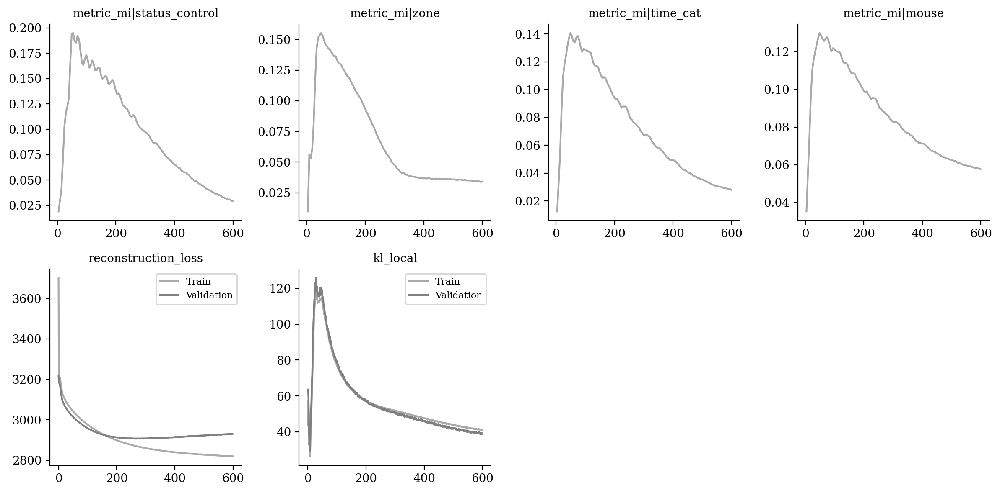

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

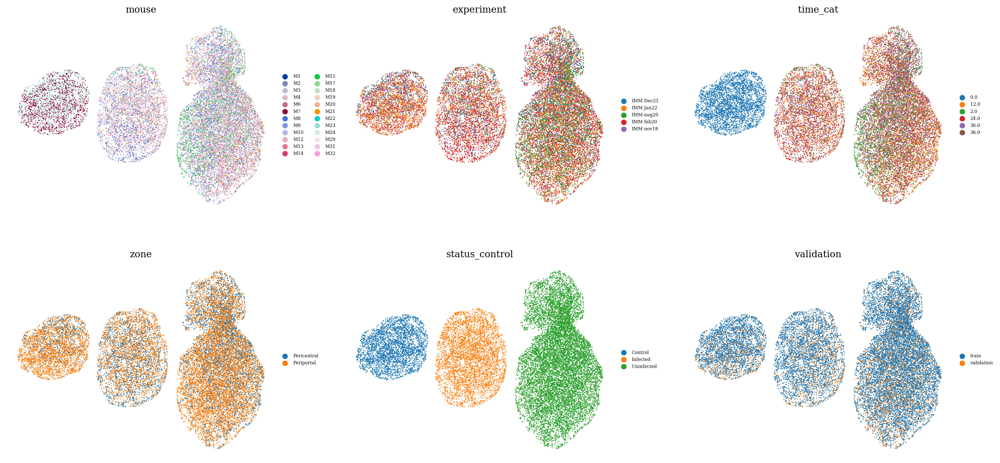

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

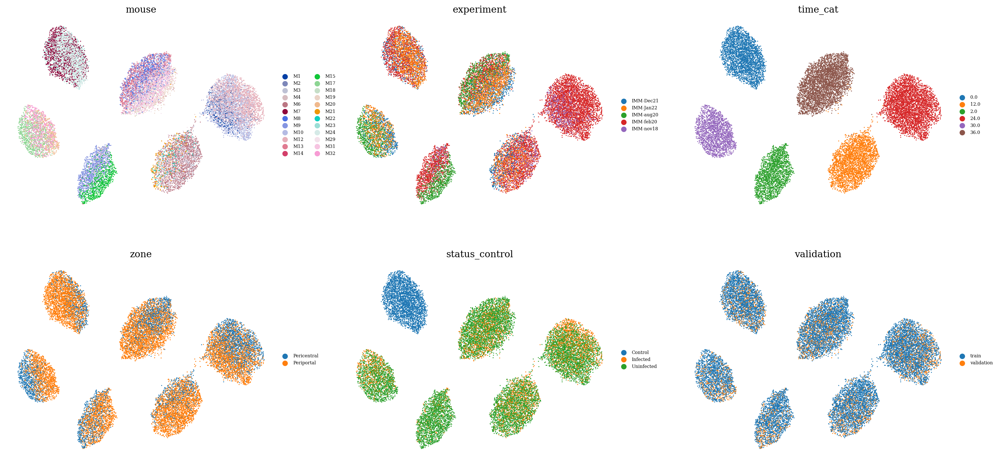

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

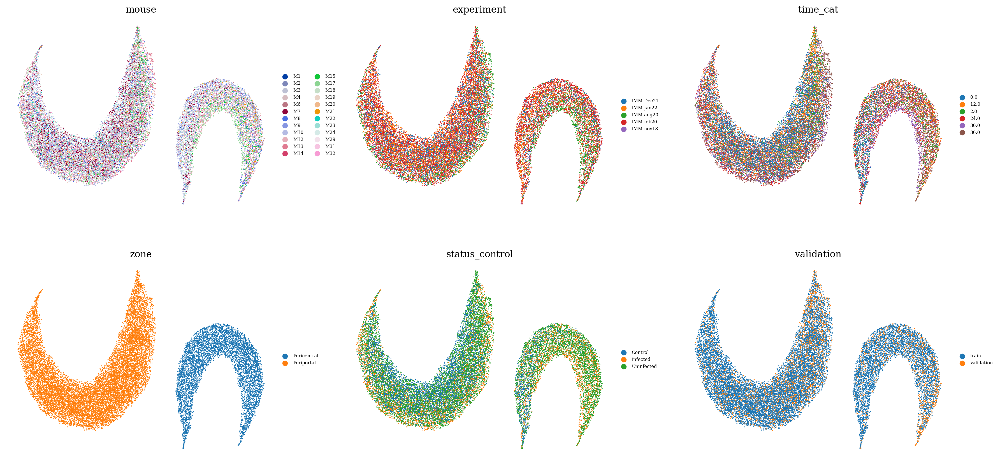

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

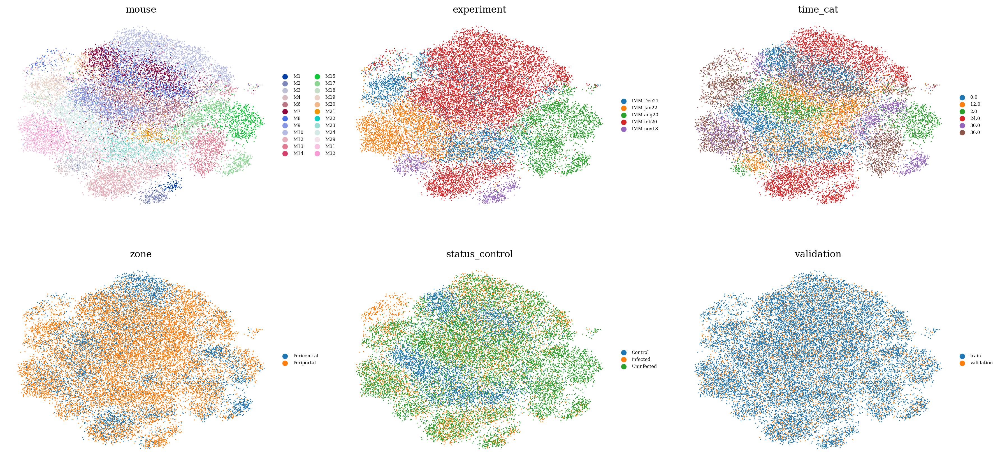

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

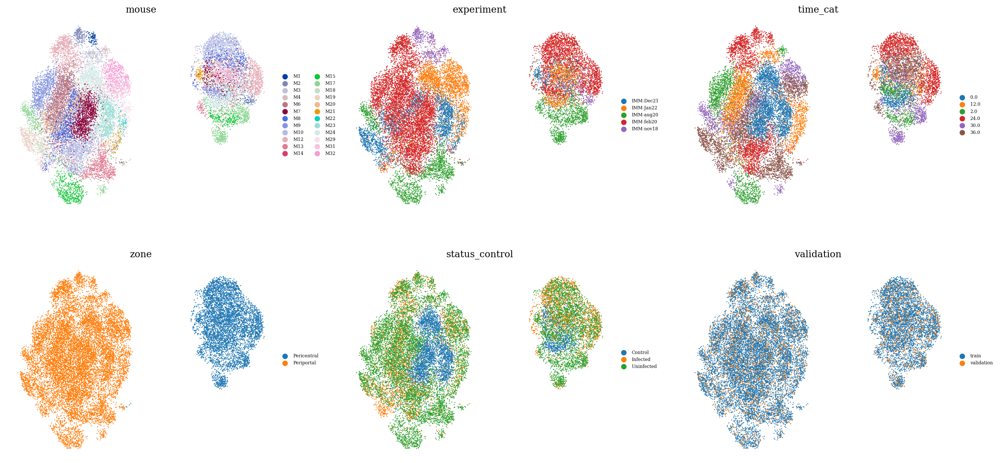

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

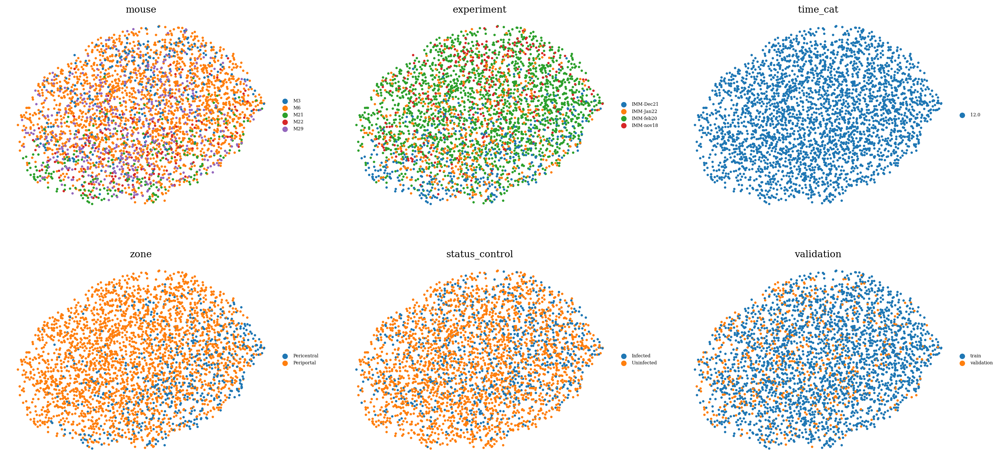

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )